## initialization

In [1]:
#import the library
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
from gprofiler import GProfiler
import seaborn as sns
import rpy2.rinterface_lib.callbacks
import logging

from rpy2.robjects import pandas2ri
import anndata2ri

import importlib
import warnings
warnings.filterwarnings("ignore")

import pickle as pkl
from matplotlib.colors import LinearSegmentedColormap

In [2]:
#adata.write('PB_integrated.h5ad')
#adata = sc.read_h5ad('PB_annotated.h5ad')

In [3]:
def print_full(x):
    pd.set_option('display.max_rows', len(x))
    print(x)
    pd.reset_option('display.max_rows')

In [4]:
adata= sc.read_h5ad('Processed_control_only.h5ad')

In [5]:
my_palette = ['#0351A8','#8CB0E0','#D56D11','#FFBB78','#234E08','#53CB8B','#D30083','#CB788D','#4E195A','#C58CCF','#AA290F','#B03FD1','#E8BCCF','#64605F','#B2AD9A','#D2D30B','#D1BD4F','#06DCF2','#9EDAE5','#517219','#5B43CF','#D92F24','#FFD900','#002F33','#B8A3A3']

In [6]:
twenty_palette = ['#0010ff', '#8400ff', '#00ffcd', '#e2ff00', '#00e5ff', 
 '#3700ff', '#08ff00', '#9cff00', '#cb00ff', '#ff8e00', 
 '#009eff', '#4fff00', '#ff005f', '#0057ff', '#00ff3f', 
 '#ffd500', '#00ff86', '#ff00a6', '#ff00ed', '#ff4700']


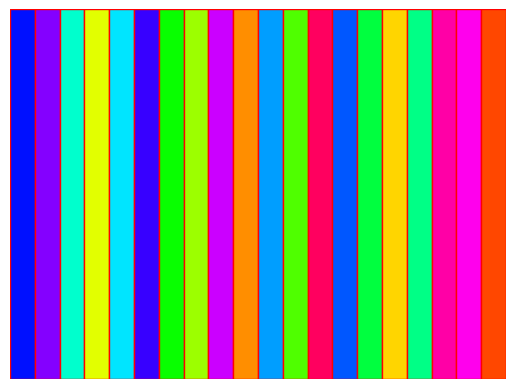

In [7]:
import matplotlib.patches as patches

# List of color codes
colors = twenty_palette

# Create a figure and a subplot
fig, ax = plt.subplots()

# Display each color
for i, color in enumerate(colors):
    # Create a rectangle patch and add it to the subplot
    rect = patches.Rectangle((i, 0), 1, 1, linewidth=1, edgecolor='r', facecolor=color)
    ax.add_patch(rect)

# Set the limits of the subplot to the number of colors
ax.set_xlim(0, len(colors))
ax.set_ylim(0, 1)

# Remove the axes
ax.axis('off')

# Show the plot
plt.show()

In [8]:
from matplotlib.colors import LinearSegmentedColormap
values = [0,1]
colors = [(227, 227, 227), (255, 42, 18)]
norm = plt.Normalize(min(values), max(values))
my_cmap = LinearSegmentedColormap.from_list(
    '', [(norm(value), tuple(np.array(color) / 255)) for value, color in zip(values, colors)])
my_cmap.set_bad(color='#E3E3E3')

In [87]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

plt.rcParams['figure.figsize']=(8,8) #rescale figures
sc.settings.verbosity = 3
#sc.set_figure_params(dpi=200, dpi_save=300)

In [89]:
%R .libPaths(.libPaths('C:\\Users\\16220\\AppData\\Local\\R\\win-library\\4.3'))
%R library(Seurat)

Exception ignored from cffi callback <function _consolewrite_ex at 0x0000021326C8FD30>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte
Exception ignored from cffi callback <function _consolewrite_ex at 0x0000021326C8FD30>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

'Seurat','SeuratOb...,'sp',...,'datasets','methods','base'


## Preprocess

In [21]:
adata1 = sc.read_10x_h5('C1_filtered_feature_bc_matrix.h5')
adata2 = sc.read_10x_h5('C2_filtered_feature_bc_matrix.h5')

reading C1_filtered_feature_bc_matrix.h5
 (0:00:00)
reading C2_filtered_feature_bc_matrix.h5
 (0:00:00)


In [22]:
adata1.var_names_make_unique()
adata2.var_names_make_unique()

In [23]:
# Quality control - calculate QC covariates
adata1.obs['n_counts'] = adata1.X.sum(1)
adata1.obs['log_counts'] = np.log(adata1.obs['n_counts'])
adata1.obs['n_genes'] = (adata1.X > 0).sum(1)
adata1.obs['log10GenesPerUMI'] = np.log10(adata1.obs['n_genes'])/np.log10(adata1.obs['n_counts'])

mt_gene_mask = [gene.startswith('MT-') for gene in adata1.var_names]
adata1.obs['mt_frac'] = np.array(adata1.X[:, mt_gene_mask].sum(1).ravel())[0]/adata1.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata1.var_names]
adata1.obs['ribo_frac'] = np.array(adata1.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata1.obs['n_counts']

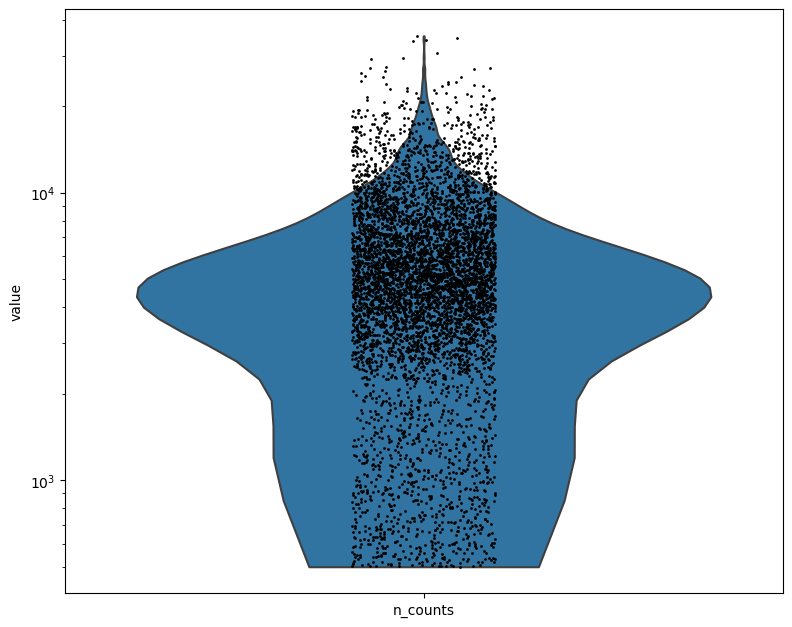

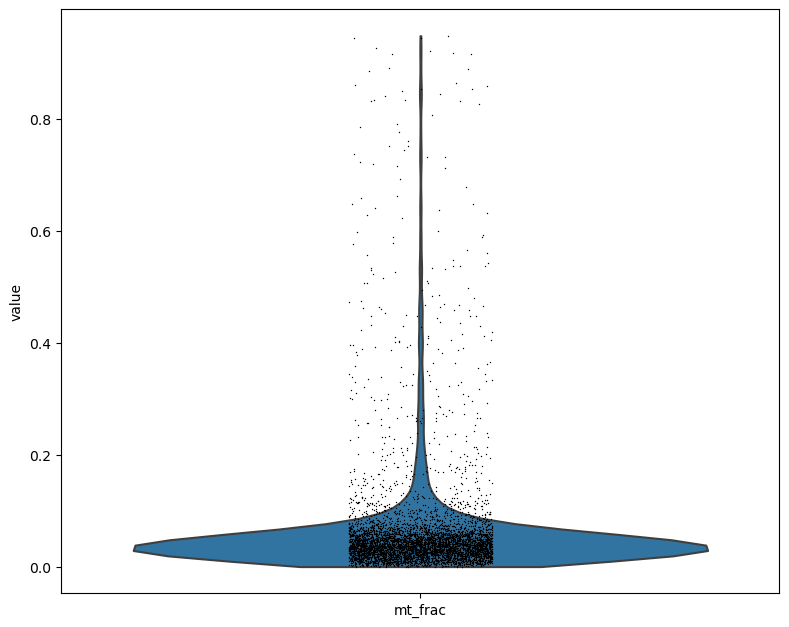

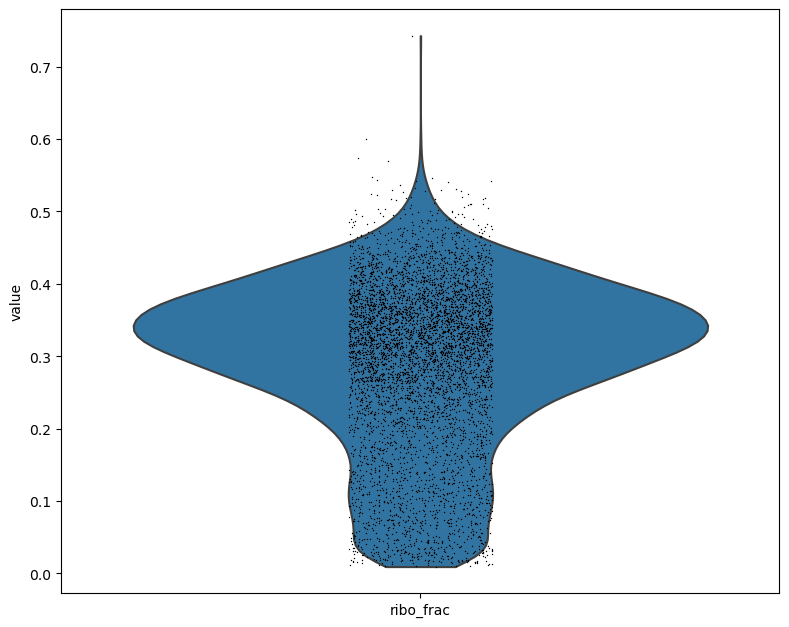

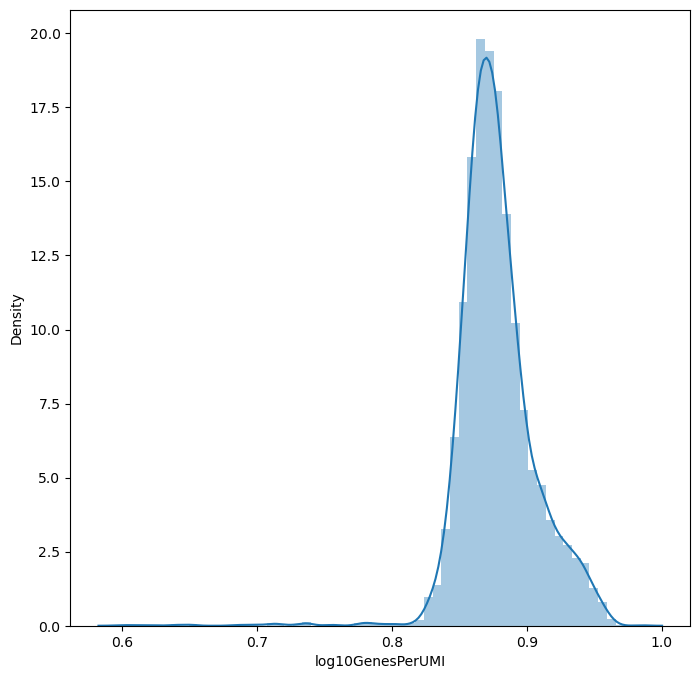

In [24]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata1, 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata1, 'mt_frac')
t3 = sc.pl.violin(adata1, 'ribo_frac')
t4 = sns.distplot(adata1.obs['log10GenesPerUMI'],bins = 60)

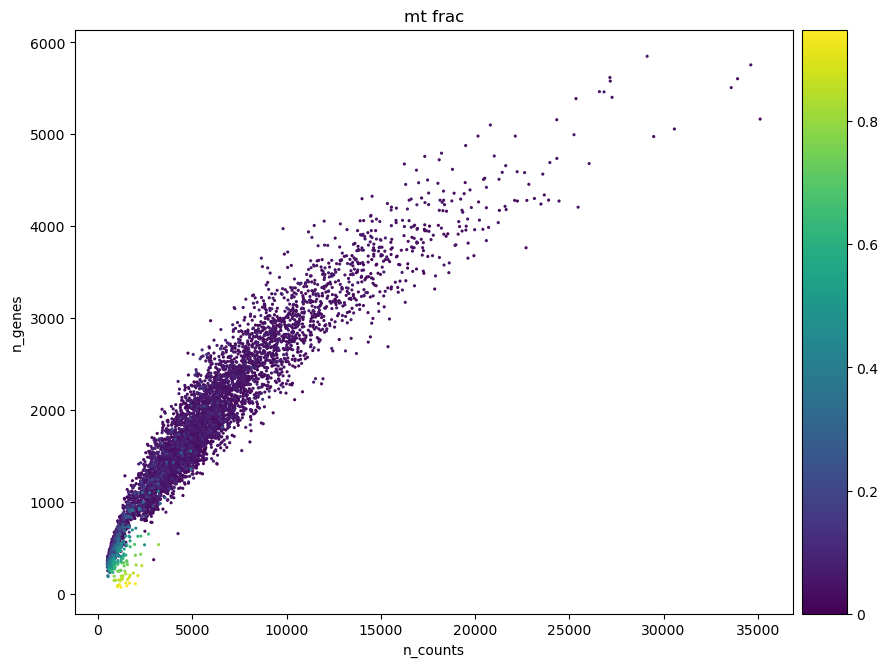

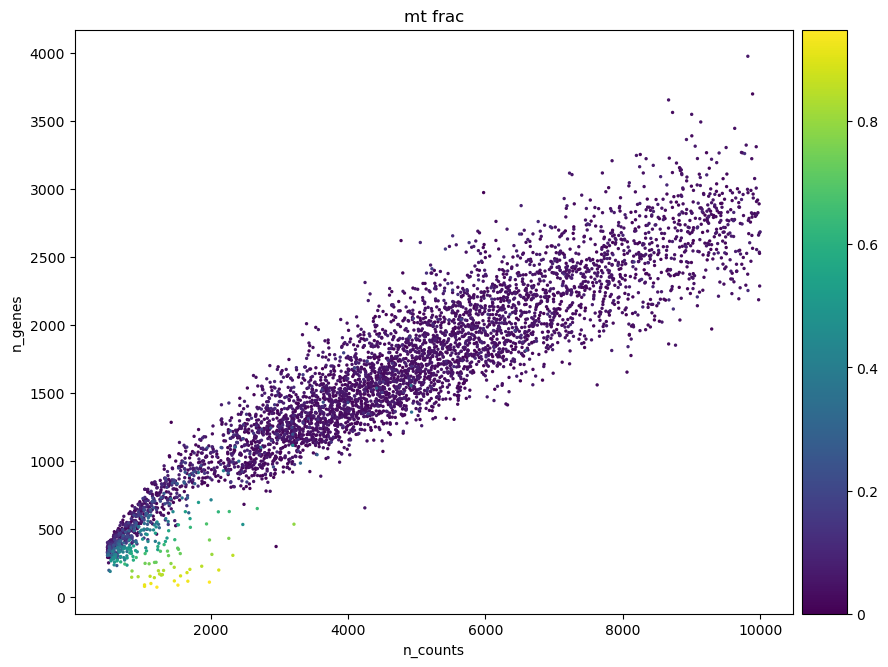

In [25]:
#Data quality summary plots
p1 = sc.pl.scatter(adata1, 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata1[adata1.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

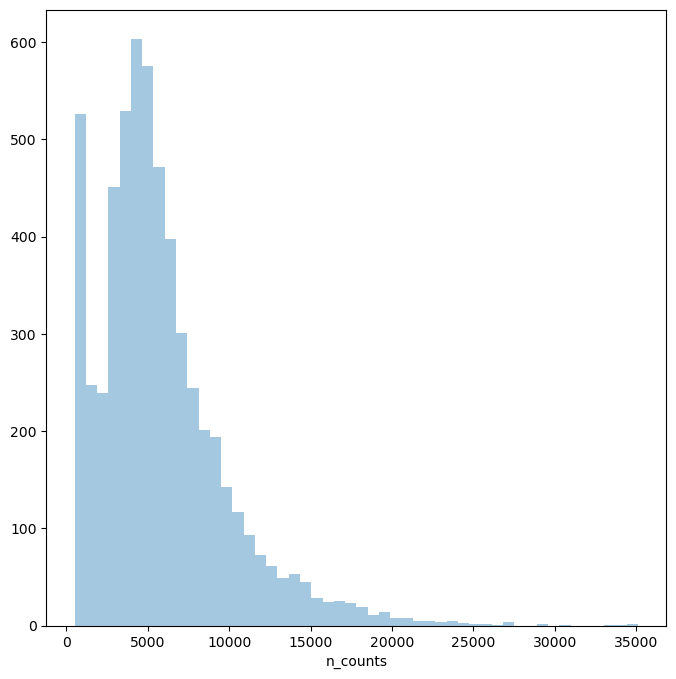

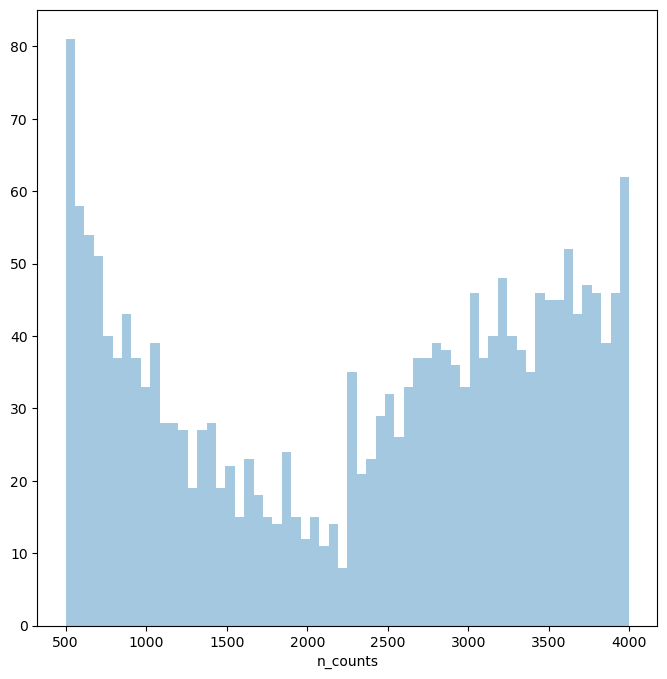

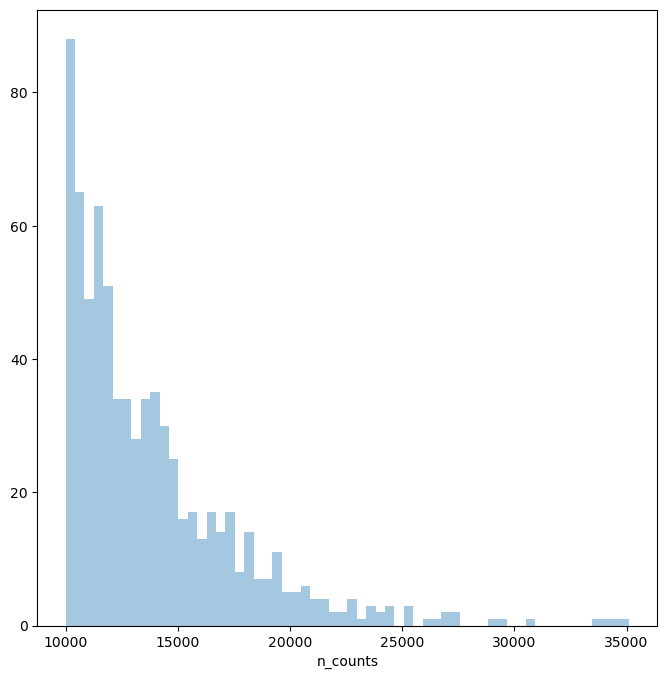

In [26]:
#Thresholding decision: counts
p3 = sns.distplot(adata1.obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata1.obs['n_counts'][adata1.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata1.obs['n_counts'][adata1.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

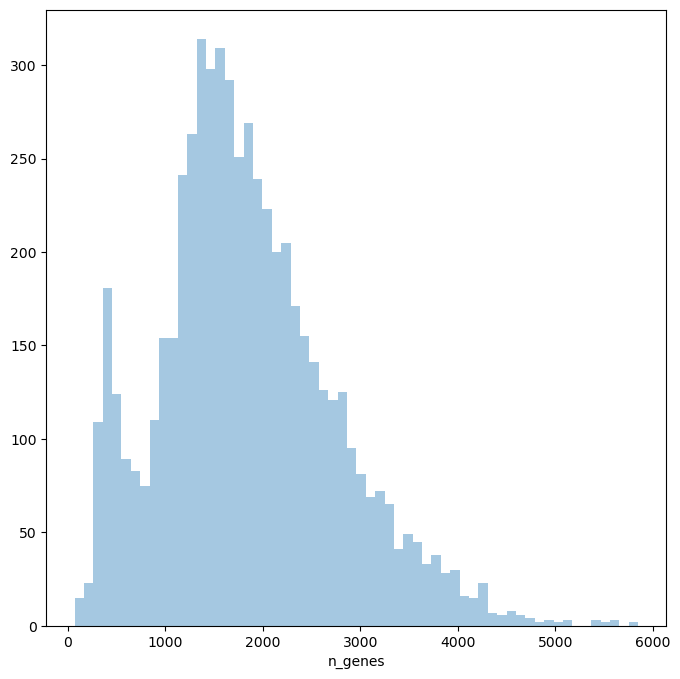

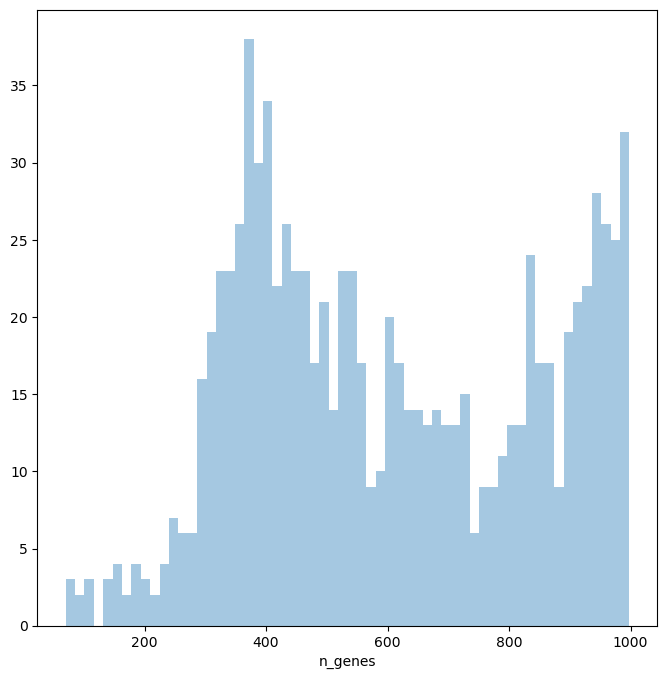

In [27]:
#Thresholding decision: genes
p6 = sns.distplot(adata1.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata1.obs['n_genes'][adata1.obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [28]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata1.n_obs))

sc.pp.filter_cells(adata1, min_counts = 2250)
print('Number of cells after min count filter: {:d}'.format(adata1.n_obs))

#sc.pp.filter_cells(adata1, max_counts = 15000)
#print('Number of cells after max count filter: {:d}'.format(adata1.n_obs))

adata1 = adata1[adata1.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata1.n_obs))

sc.pp.filter_cells(adata1, min_genes = 770)
print('Number of cells after gene filter: {:d}'.format(adata1.n_obs))

adata1 = adata1[adata1.obs['log10GenesPerUMI'] > 0.8]
print('Number of cells after complexity filter: {:d}'.format(adata1.n_obs))

Total number of cells: 5811
filtered out 855 cells that have less than 2250 counts
Number of cells after min count filter: 4956
Number of cells after MT filter: 4932
filtered out 3 cells that have less than 770 genes expressed
Number of cells after gene filter: 4929
Number of cells after complexity filter: 4929


In [29]:
# Quality control - calculate QC covariates
adata2.obs['n_counts'] = adata2.X.sum(1)
adata2.obs['log_counts'] = np.log(adata2.obs['n_counts'])
adata2.obs['n_genes'] = (adata2.X > 0).sum(1)

mt_gene_mask = [gene.startswith('MT-') for gene in adata2.var_names]
adata2.obs['mt_frac'] = np.array(adata2.X[:, mt_gene_mask].sum(1).ravel())[0]/adata2.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata2.var_names]
adata2.obs['ribo_frac'] = np.array(adata2.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata2.obs['n_counts']
adata2.obs['log10GenesPerUMI'] = np.log10(adata2.obs['n_genes'])/np.log10(adata2.obs['n_counts'])

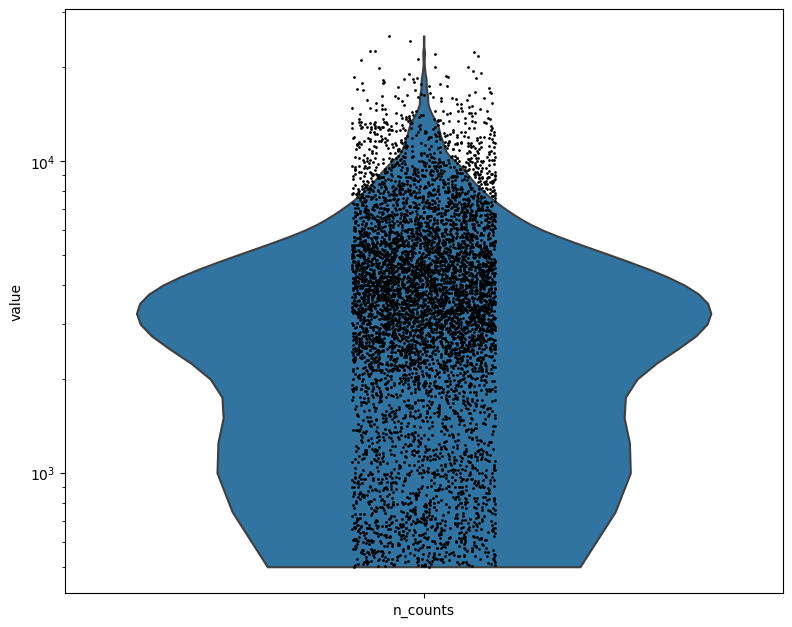

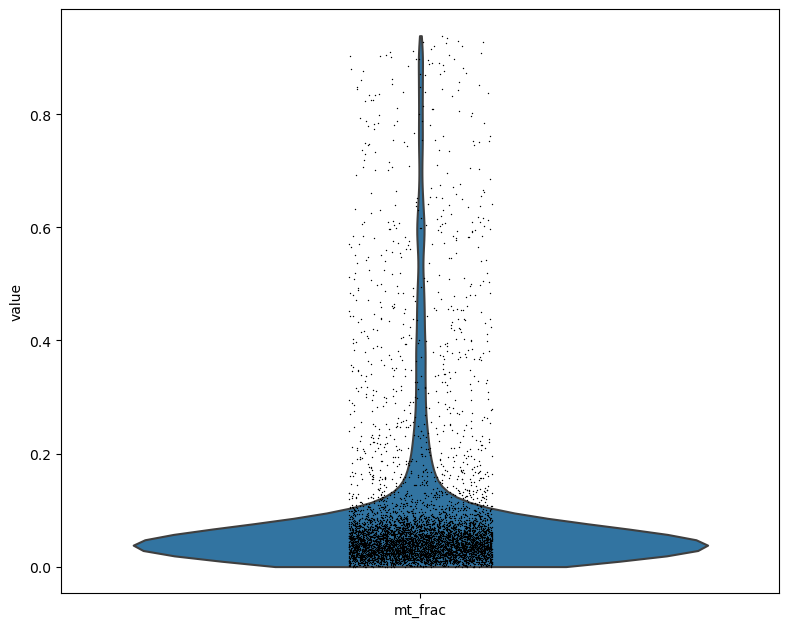

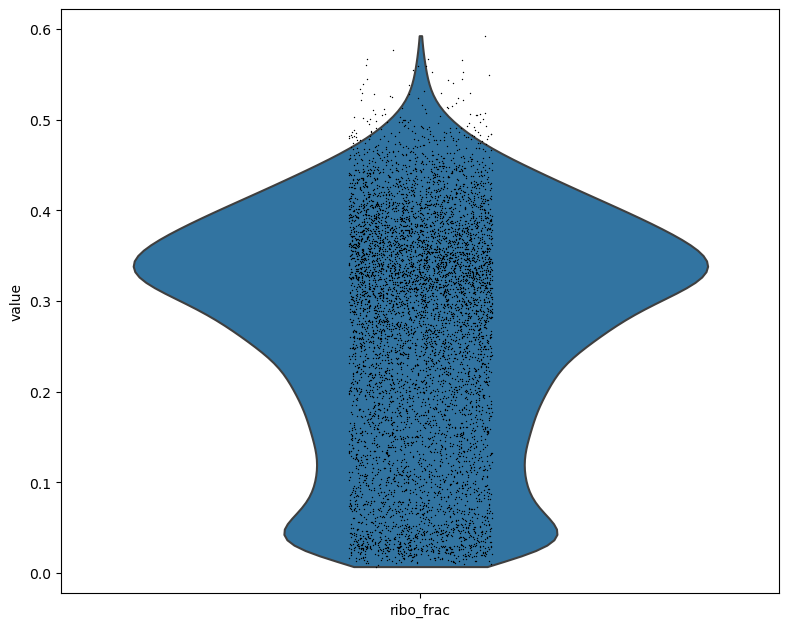

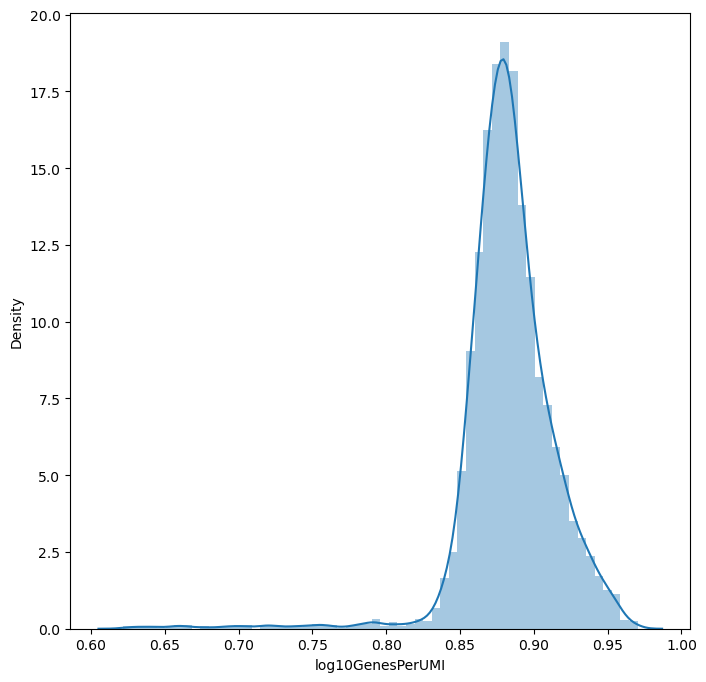

In [30]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata2, 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata2, 'mt_frac')
t3 = sc.pl.violin(adata2, 'ribo_frac')
t4 = sns.distplot(adata2.obs['log10GenesPerUMI'],bins = 60)

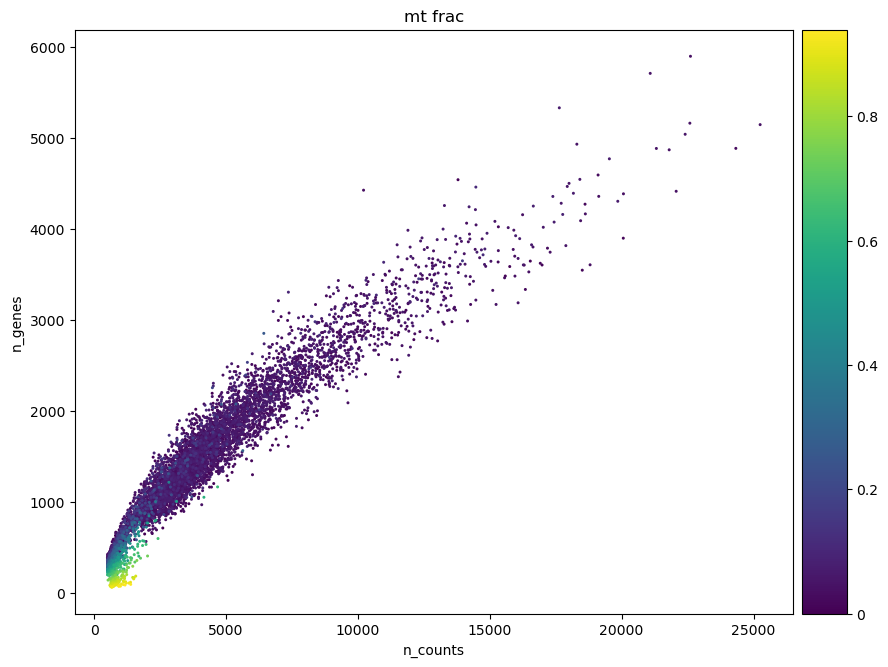

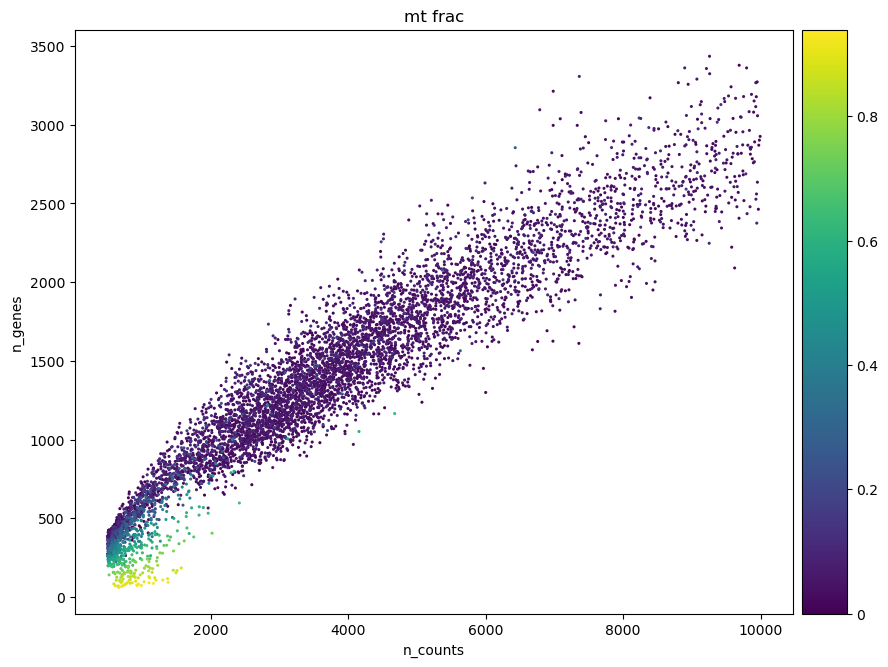

In [31]:
#Data quality summary plots
p1 = sc.pl.scatter(adata2, 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata2[adata2.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

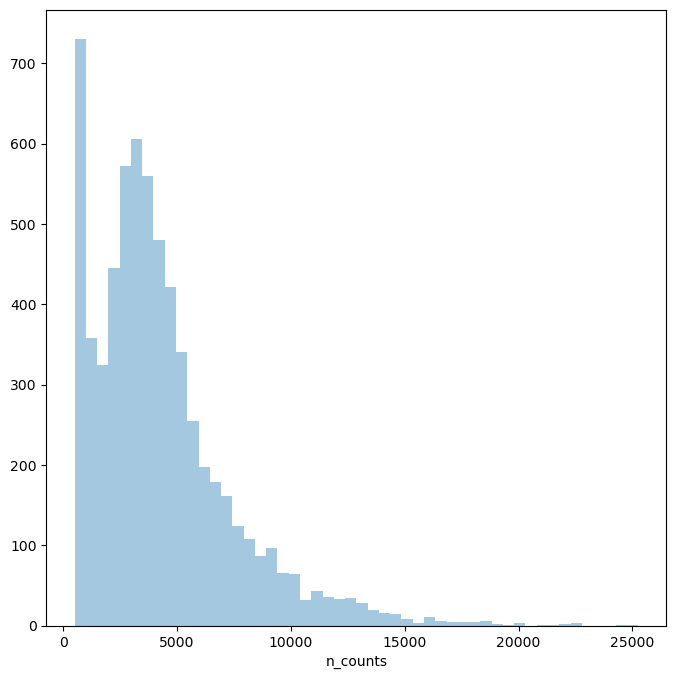

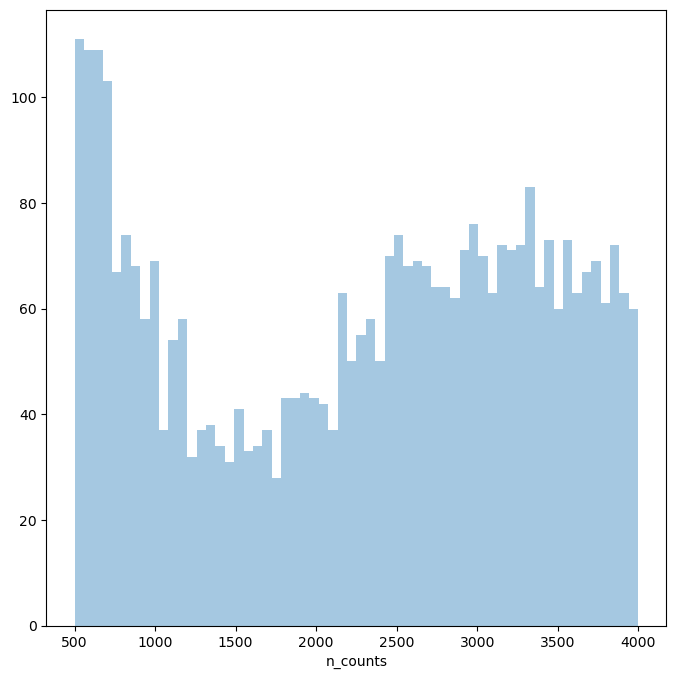

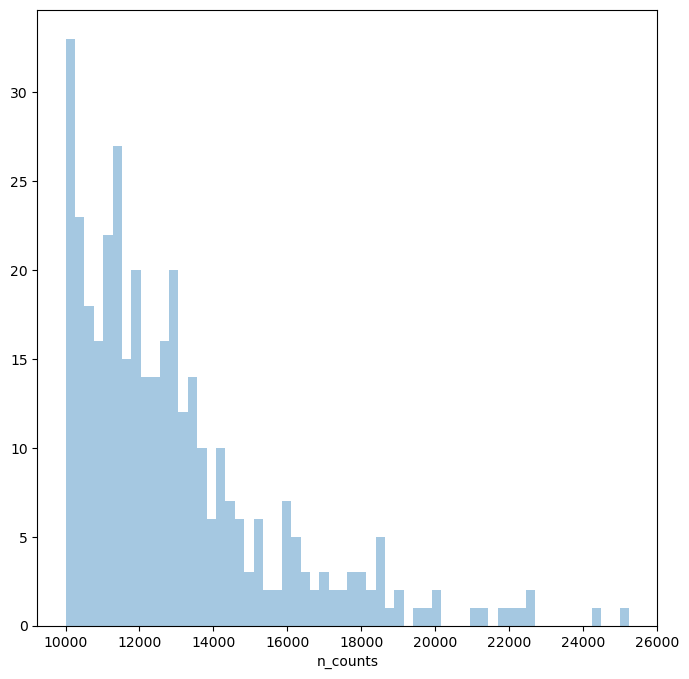

In [32]:
#Thresholding decision: counts
p3 = sns.distplot(adata2.obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata2.obs['n_counts'][adata2.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata2.obs['n_counts'][adata2.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

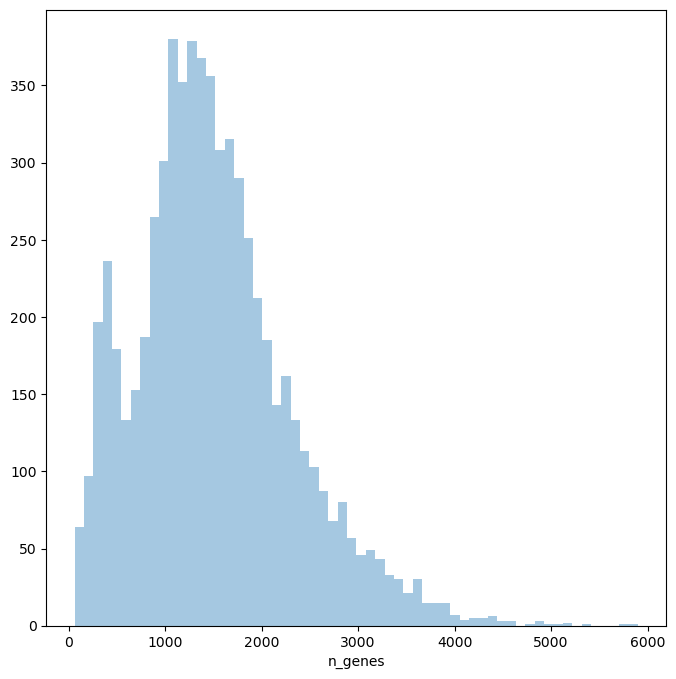

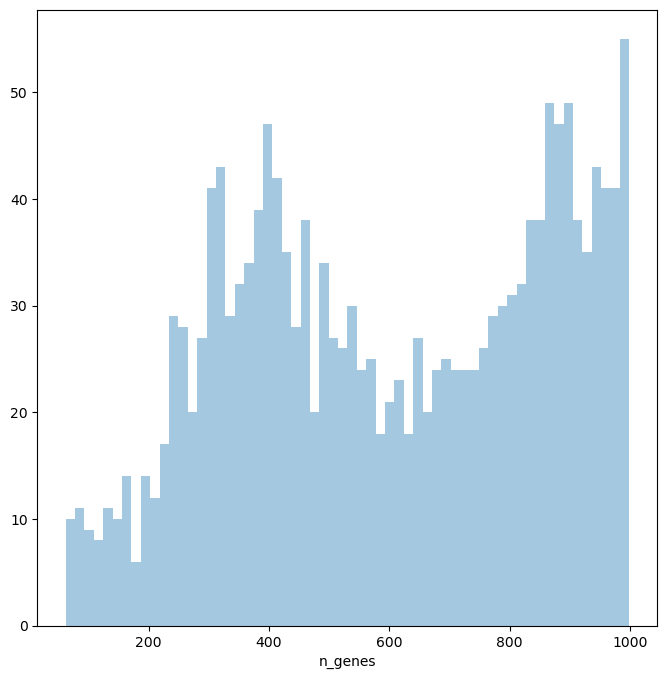

In [33]:
#Thresholding decision: genes
p6 = sns.distplot(adata2.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata2.obs['n_genes'][adata2.obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [34]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata2.n_obs))

sc.pp.filter_cells(adata2, min_counts = 1500)
print('Number of cells after min count filter: {:d}'.format(adata2.n_obs))

#sc.pp.filter_cells(adata2, max_counts = 15000)
#print('Number of cells after max count filter: {:d}'.format(adata2.n_obs))

adata2 = adata2[adata2.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata2.n_obs))

sc.pp.filter_cells(adata2, min_genes = 700)
print('Number of cells after gene filter: {:d}'.format(adata2.n_obs))

adata2 = adata2[adata2.obs['log10GenesPerUMI'] > 0.8]
print('Number of cells after complexity filter: {:d}'.format(adata2.n_obs))

Total number of cells: 6495
filtered out 1095 cells that have less than 1500 counts
Number of cells after min count filter: 5400
Number of cells after MT filter: 5320
filtered out 13 cells that have less than 700 genes expressed
Number of cells after gene filter: 5307
Number of cells after complexity filter: 5307


## Scrublet and doubletdetection don't work well. Set threshold manually

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.72
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 6.1%
Elapsed time: 4.7 seconds
Detected doublet rate = 10.1%
Estimated detectable doublet fraction = 55.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 18.1%


(<Figure size 800x300 with 2 Axes>,
 array([<Axes: title={'center': 'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <Axes: title={'center': 'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

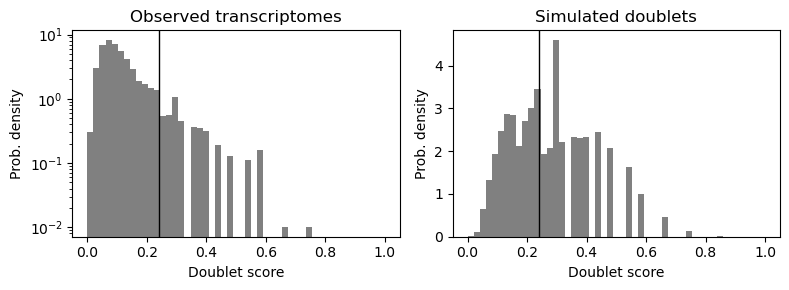

In [35]:
import scrublet as scr
scrub = scr.Scrublet(adata1.X)
scrub.scrub_doublets()
adata1.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)
scrub.plot_histogram()

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.72
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.7%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.7%
Elapsed time: 4.6 seconds
Detected doublet rate = 8.8%
Estimated detectable doublet fraction = 52.4%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 16.7%


(<Figure size 800x300 with 2 Axes>,
 array([<Axes: title={'center': 'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <Axes: title={'center': 'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

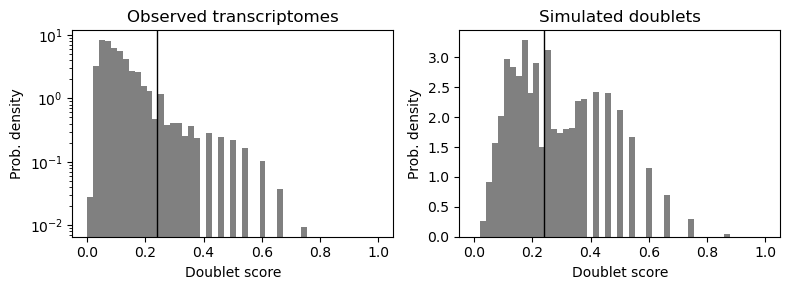

In [36]:
scrub = scr.Scrublet(adata2.X)
scrub.scrub_doublets()
adata2.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)
scrub.plot_histogram()

In [37]:
adata1 = adata1[~adata1.obs['predicted_doublets'],:]
adata2 = adata2[~adata2.obs['predicted_doublets'],:]

In [38]:
sc.pp.filter_genes(adata1, min_cells = 5)
sc.pp.filter_genes(adata2, min_cells = 5)

filtered out 16406 genes that are detected in less than 5 cells
filtered out 16538 genes that are detected in less than 5 cells


In [39]:
adata_concat = adata1.concatenate(adata2, batch_categories=['control_1', 'control_2'])

In [40]:
adata_concat.layers['raw_filtered'] = adata_concat.X

In [41]:
adata_concat.obs['n_counts'] = adata_concat.X.sum(1)
adata_concat.obs['log_counts'] = np.log(adata_concat.obs['n_counts'])
adata_concat.obs['n_genes'] = (adata_concat.X > 0).sum(1)
adata_concat.obs['log10GenesPerUMI'] = np.log10(adata_concat.obs['n_genes'])/np.log10(adata_concat.obs['n_counts'])

mt_gene_mask = [gene.startswith('MT-') for gene in adata_concat.var_names]
adata_concat.obs['mt_frac'] = np.array(adata_concat.X[:, mt_gene_mask].sum(1).ravel())[0]/adata_concat.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_concat.var_names]
adata_concat.obs['ribo_frac'] = np.array(adata_concat.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata_concat.obs['n_counts']

## For cell cycle run before the SCTransform

In [42]:
adata_forcycle = adata_concat.copy()
sc.pp.normalize_total(adata_forcycle, key_added = 'normalization_factors')
sc.pp.log1p(adata_forcycle)

normalizing counts per cell
    finished (0:00:00)


In [43]:
sc.pp.highly_variable_genes(adata_forcycle, flavor='seurat', n_top_genes=1000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_forcycle.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 1000


In [44]:
sc.pp.pca(adata_forcycle, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_forcycle, n_neighbors = 15, n_pcs = 50)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:26)


In [45]:
sc.tl.umap(adata_forcycle, min_dist = 0.4, spread = 1.2)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


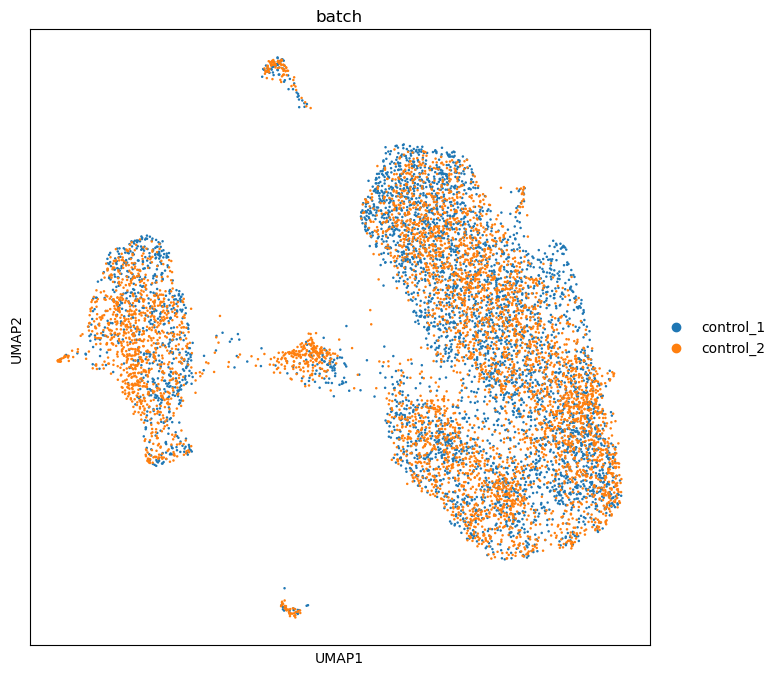

In [46]:
sc.pl.umap(adata_forcycle, color='batch')

In [47]:
cc_genes = pd.read_excel('Triosh_cc.xlsx')

In [48]:
s_genes = cc_genes['G1/S'].dropna()
g2m_genes = cc_genes['G2/M'].dropna()

s_genes_mm_ens = adata_forcycle.var_names[np.in1d(adata_forcycle.var_names, s_genes)]
g2m_genes_mm_ens = adata_forcycle.var_names[np.in1d(adata_forcycle.var_names, g2m_genes)]

In [49]:
sc.tl.score_genes_cell_cycle(adata_forcycle, s_genes=s_genes_mm_ens, g2m_genes=g2m_genes_mm_ens)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    710 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    627 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


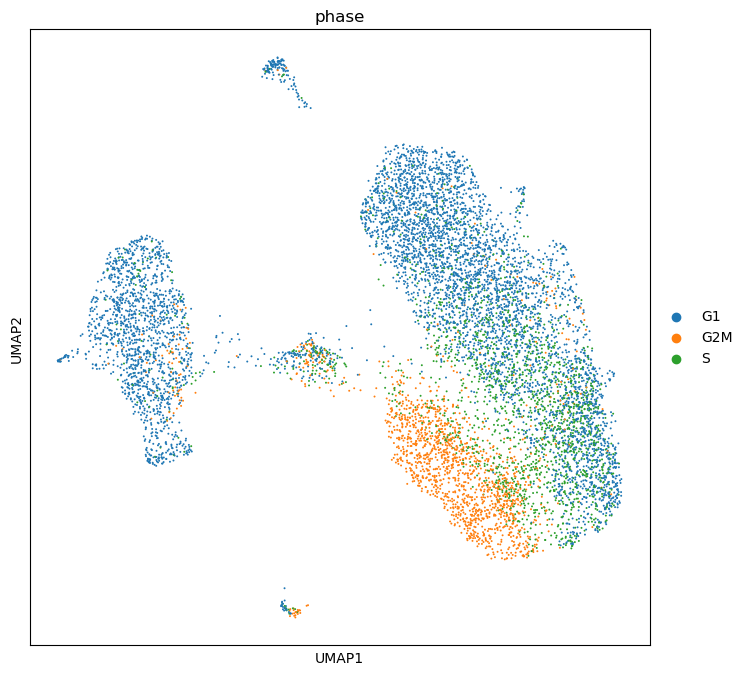

In [50]:
sc.pl.umap(adata_forcycle, color='phase',size = 8)

In [51]:
Sscore = adata_forcycle.obs['S_score'].values.tolist()
G2Mscore = adata_forcycle.obs['G2M_score'].values.tolist()
S_G2M_diff = adata_forcycle.obs['S_score'] - adata_forcycle.obs['G2M_score']
S_G2M_diff = S_G2M_diff.values.tolist()

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


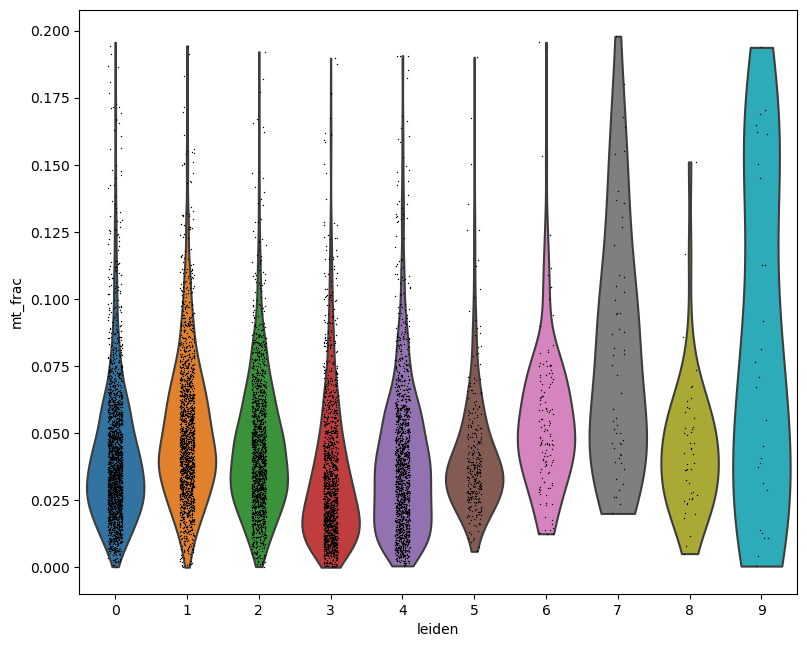

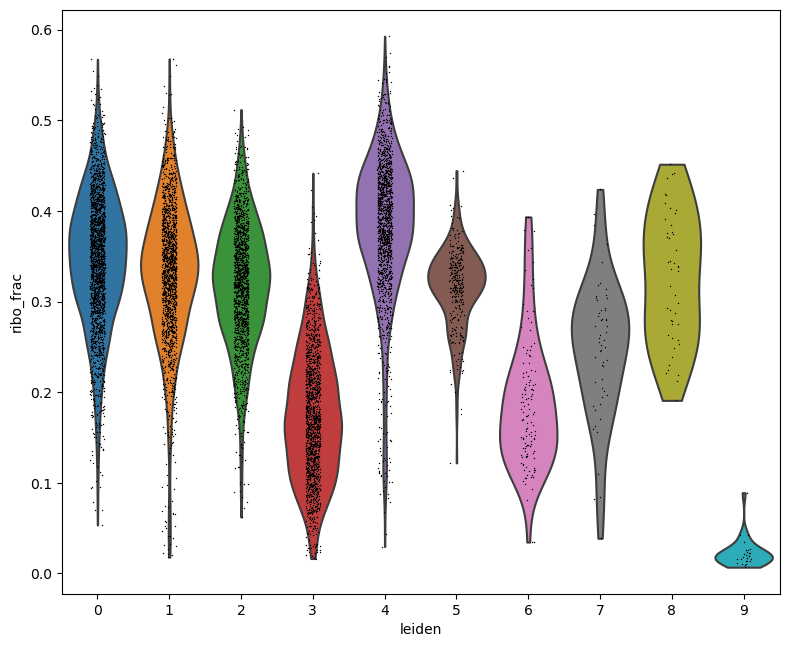

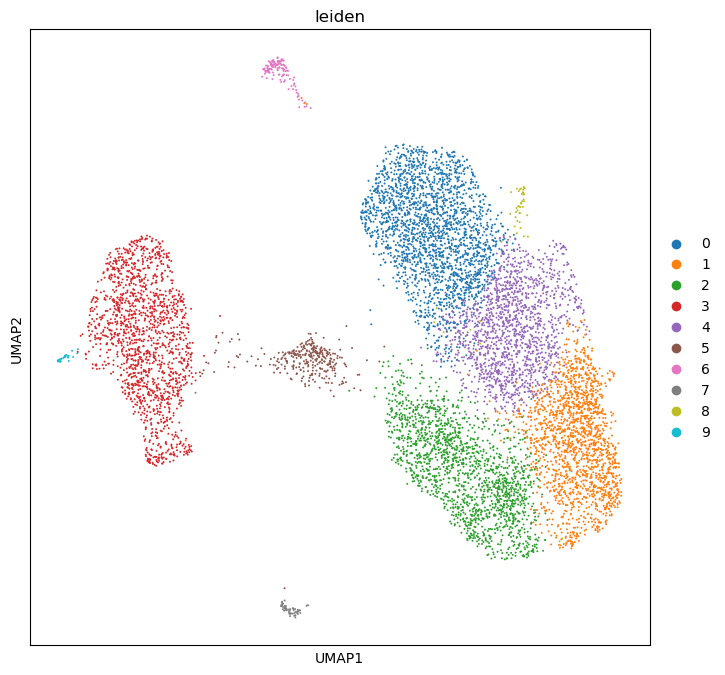

In [52]:
sc.tl.leiden(adata_forcycle, resolution = 0.6, key_added= 'leiden')
t1 = sc.pl.violin(adata_forcycle, 'mt_frac', groupby = 'leiden')
t2 = sc.pl.violin(adata_forcycle, 'ribo_frac', groupby = 'leiden')
t3 = sc.pl.umap(adata_forcycle, color='leiden',size = 8)

## Back to the SCTransform

In [56]:
adata_concat.uns['allgenes'] = list(adata1.var_names)
adata_concat.obs['S_score'] = adata_forcycle.obs['S_score']
adata_concat.obs['G2M_score'] = adata_forcycle.obs['G2M_score']
adata_concat.obs['S_G2M_diff'] = adata_concat.obs['S_score'] - adata_concat.obs['G2M_score']
adata_concat.obs['phase'] = adata_forcycle.obs['phase']

In [57]:
colnames = adata_concat.obs_names
rownames = adata_concat.var_names
condition = adata_concat.obs['batch']
mt_frac = adata_concat.obs['mt_frac']
S_G2M_diff = adata_concat.obs['S_score'] - adata_concat.obs['G2M_score']
S_G2M_diff = S_G2M_diff.values.tolist()

In [58]:
%%R -i adata_concat -i colnames -i rownames -i S_G2M_diff -i mt_frac -i condition
counts = adata_concat@assays@data$X
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "transwell", min.cells = 0, min.features = 0, assay = "RNA")

srat[["S_G2M_diff"]] = S_G2M_diff
srat[["cond"]] = condition
srat[["mt_frac"]] = mt_frac

### Separate

In [60]:
%%R
cond.list = SplitObject(srat, split.by = "cond")
ctrl1 <- cond.list[["control_1"]]
ctrl2 <- cond.list[["control_2"]]

ctrl1 = SCTransform(object = ctrl1, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("S_G2M_diff","mt_frac")) #c("G2Mscore","Sscore"))

ctrl1 = RunPCA(ctrl1, verbose = FALSE)

ctrl2 = SCTransform(object = ctrl2, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("S_G2M_diff","mt_frac")) #c("G2Mscore","Sscore"))

ctrl2 = RunPCA(ctrl2, verbose = FALSE)

In [61]:
%%R
ifnb.list <- list(ctrl1 = ctrl1, ctrl2 = ctrl2)
features <- SelectIntegrationFeatures(object.list = ifnb.list, nfeatures = 3000)
ifnb.list <- PrepSCTIntegration(object.list = ifnb.list, anchor.features = features)

mod.anchors <- FindIntegrationAnchors(object.list = ifnb.list, normalization.method = "SCT",
    anchor.features = features)
srat_combined <- IntegrateData(anchorset = mod.anchors, normalization.method = "SCT")

  |                                                  | 0 % ~calculating   |+++++++++++++++++++++++++                         | 50% ~02s           |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=04s  
  |                                                  | 0 % ~calculating   |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=02m 07s
[1] 1
[1] 2


In [70]:
%%R -o HVG -o varExplained -o PCs -o mat -o pca_embeddings

srat_combined = RunPCA(srat_combined,verbose = FALSE)

HVG = VariableFeatures(srat_combined)

mat <- Seurat::GetAssayData(object = srat_combined, slot = 'scale.data')
pca <- srat_combined[["pca"]]
pca_embeddings = Embeddings(object = srat_combined, reduction = "pca")
# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat_combined, reduction = "pca")

In [66]:
%%R
saveRDS(srat_combined,'srat_combined.rds')

In [74]:
%%R -o counts -o logcounts -o residuals

counts = srat_combined[["SCT"]]@counts
logcounts = srat_combined[["SCT"]]@data
residuals = srat_combined[["SCT"]]@scale.data

## Transfer the result of SCTransform to python and then do the PAGA and UMAP

In [75]:
import anndata
adata = anndata.AnnData(X = logcounts.T)
adata.var_names = adata_concat.var_names
adata.obs_names = adata_concat.obs_names
adata.uns['scaled'] = mat.T
adata.layers['counts'] = counts.T
adata.uns['residuals'] = residuals.T
adata.layers['logcounts'] = logcounts.T
adata.obsm['X_pca'] = pca_embeddings
adata.layers['raw'] = adata_concat.X

In [76]:
adata.varm['PCs'] = np.zeros([np.shape(adata.X.A)[1],50])
for i in range(0,50):
    genename = HVG[i]
    adata.varm['PCs'][adata.var_names == genename,:] = PCs[i,:]

In [77]:
adata.obs['n_counts'] = adata.layers['counts'].sum(1)
adata.obs['n_genes'] = (adata.layers['counts'] > 0).sum(1)
adata.var['highly_variable'] = adata.var_names.isin(HVG)
adata.obs['condition'] = adata_concat.obs['batch']
adata.obs['phase'] = adata_concat.obs['phase']
adata.uns['pca'] = dict({'variance_ratio': varExplained})

In [78]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]
adata.obs['mt_frac'] = np.array(adata.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata.obs['n_counts']

In [79]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata.var_names]
adata.obs['ribo_frac'] = np.array(adata.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata.obs['n_counts']

In [80]:
sc.pp.neighbors(adata, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


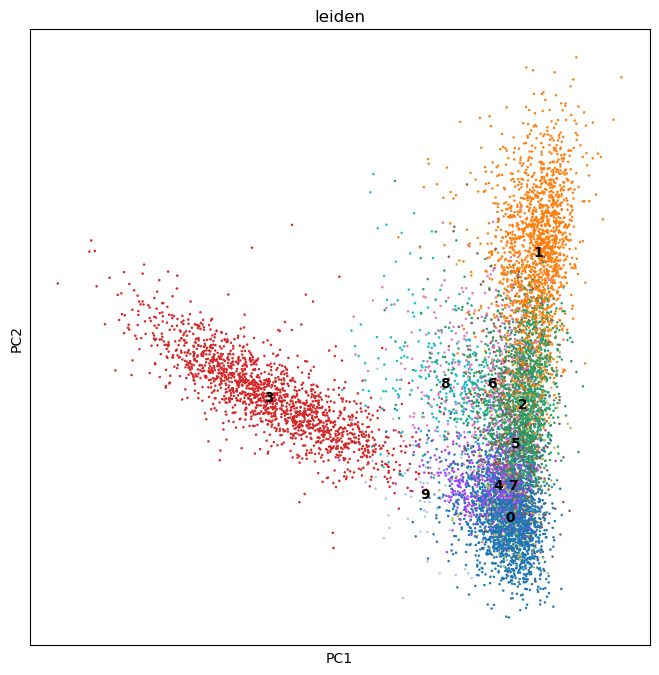

In [85]:
sc.tl.leiden(adata, resolution = 0.5, key_added= 'leiden')
sc.pl.pca(adata, color='leiden', legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


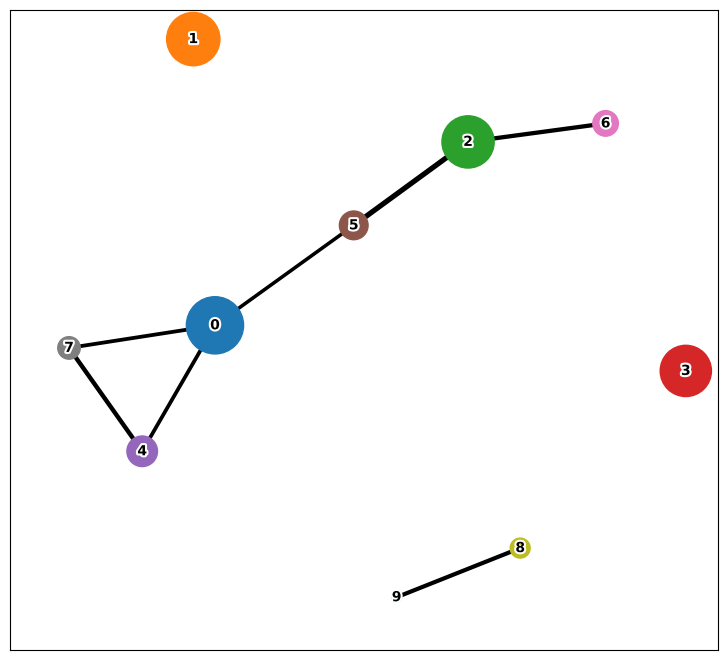

In [87]:
sc.tl.paga(adata, groups='leiden')
sc.pl.paga(adata,threshold = 0.3, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


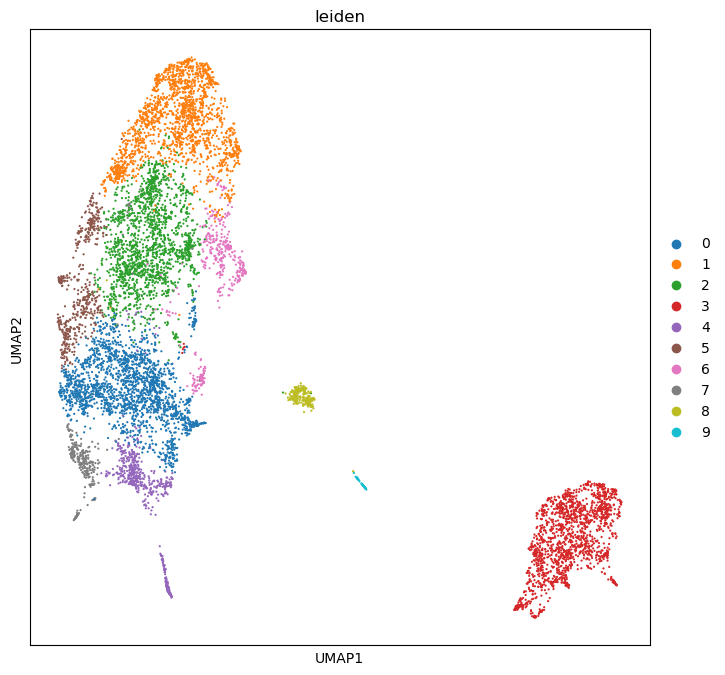

In [89]:
sc.tl.umap(adata, min_dist = 0.05, spread = 1.1,init_pos = 'paga')
sc.pl.umap(adata, color = 'leiden',size = 10)

## Use prior knowledge (i.e., who express what markers) to have an idea of what those clusters could be

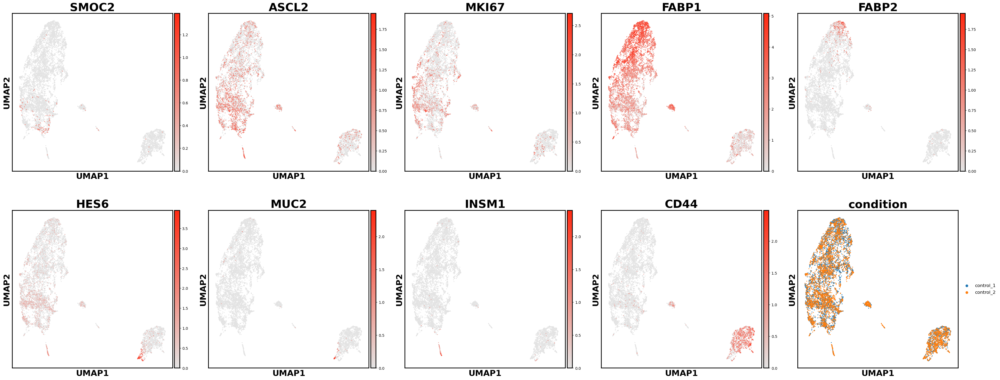

In [90]:
plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color=['SMOC2', 'ASCL2','MKI67', 'FABP1','FABP2','HES6','MUC2','INSM1','CD44','condition'],size =20, ncols = 5, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('overall_map.png')

Stem

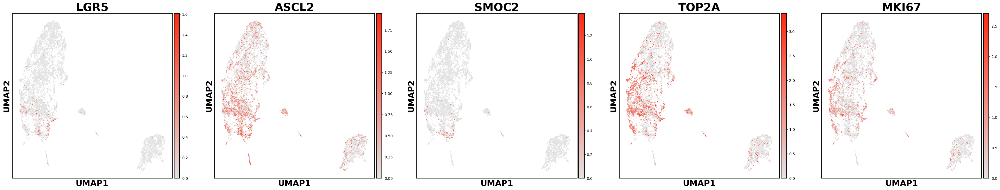

In [91]:
fig = sc.pl.umap(adata, color=['LGR5', 'ASCL2','SMOC2','TOP2A','MKI67'],size =20,ncols = 5,save = "stem_map.png",return_fig = True,cmap = my_cmap,wspace  = 0.15)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('stem_map.png')

TA

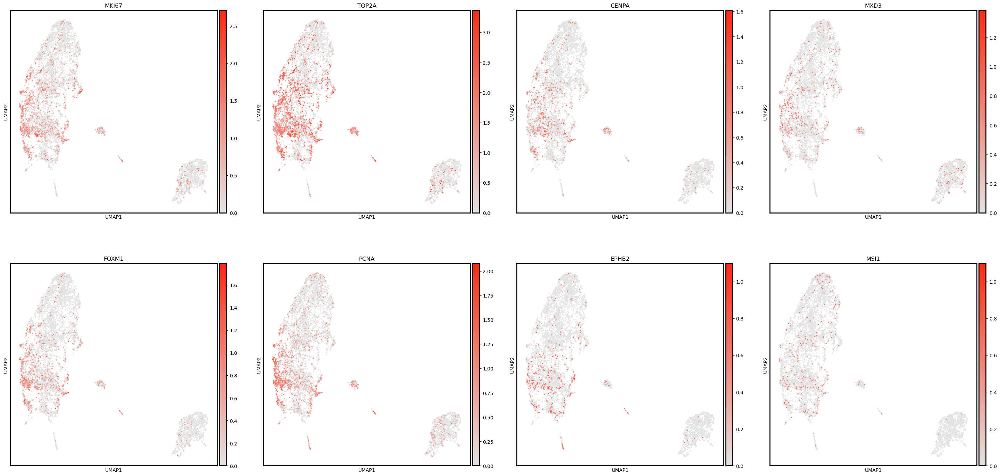

In [93]:
sc.pl.umap(adata, color=['MKI67','TOP2A','CENPA','MXD3','FOXM1','PCNA','EPHB2','MSI1'],size = 20,save = 'TA_map.png',cmap = my_cmap)

Paneth

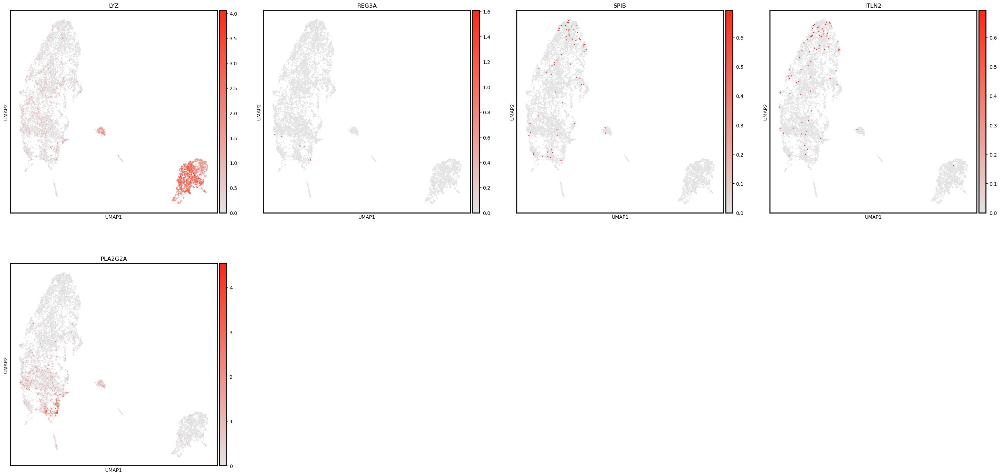

In [96]:
sc.pl.umap(adata, color=['LYZ','REG3A','SPIB','ITLN2','PLA2G2A'],cmap = my_cmap, size =20)

Sec Prog

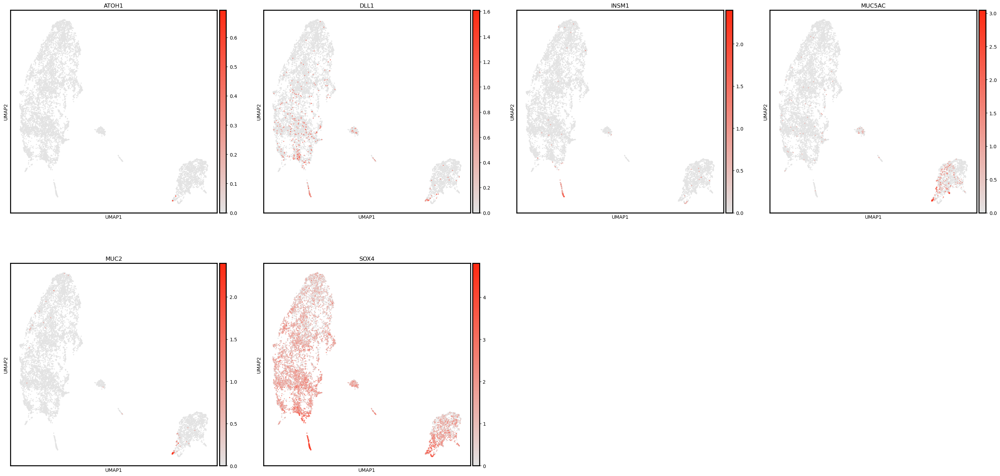

In [97]:
sc.pl.umap(adata, color=['ATOH1','DLL1','INSM1','MUC5AC','MUC2','SOX4'],cmap = my_cmap,size = 20)

Colonocytes

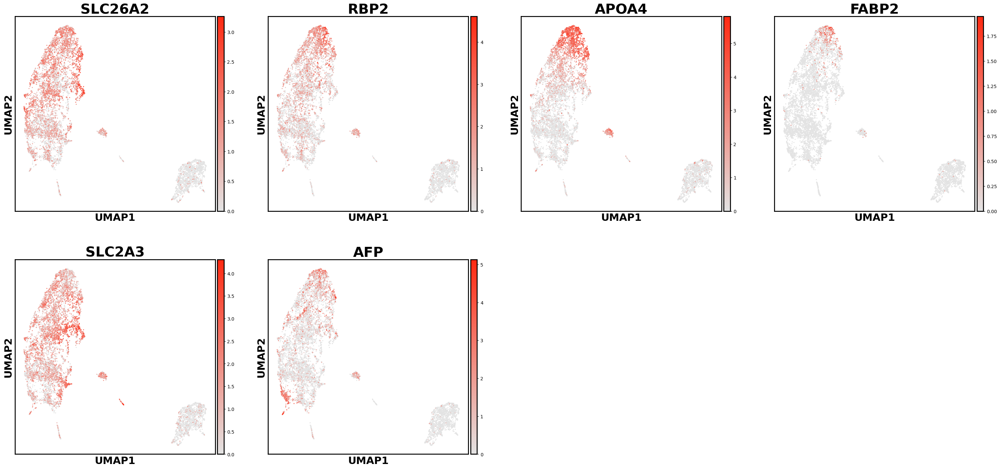

In [98]:
fig = sc.pl.umap(adata, color=['SLC26A2','RBP2','APOA4','FABP2','SLC2A3','AFP'],size = 20,save = 'EC_map.png',cmap = my_cmap,return_fig = True,wspace  = 0.15)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('EC_map.png')

Enterocytes

GOBLET

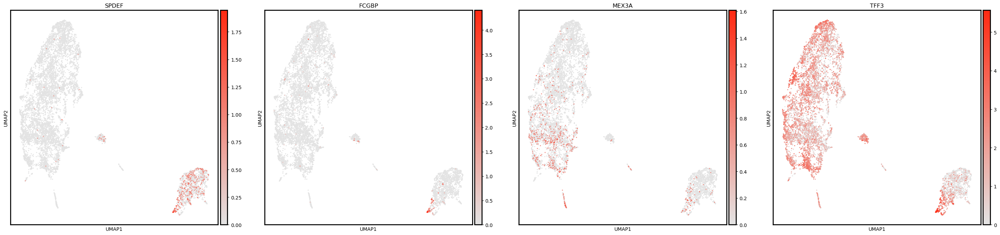

In [99]:
sc.pl.umap(adata, color=['SPDEF', 'FCGBP', 'MEX3A','TFF3'],cmap = my_cmap,size = 20)

Tuft - none

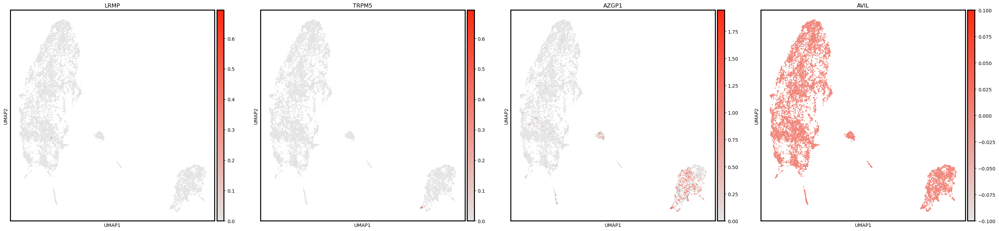

In [100]:
sc.pl.umap(adata, color = ['LRMP', 'TRPM5','AZGP1','AVIL'],cmap = my_cmap,size = 20) #overview of the graph

EEC

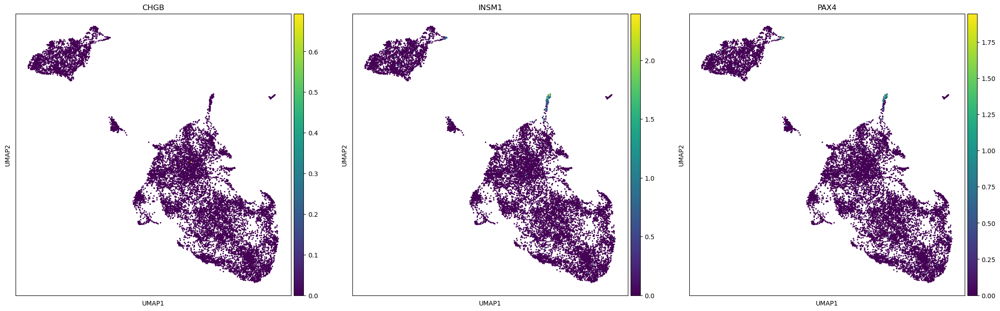

In [74]:
sc.pl.umap(adata, color = ['CHGB', 'INSM1','PAX4'],size = 20) #overview of the graph

Early EEC

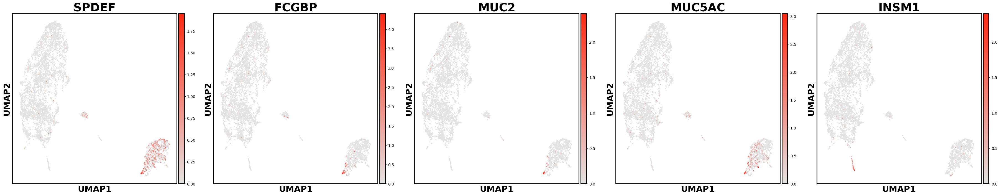

In [102]:
fig = sc.pl.umap(adata, color = ['SPDEF', 'FCGBP', 'MUC2','MUC5AC', 'INSM1'],size = 20,return_fig = True,save = 'sec_map.png',ncols = 5,cmap = my_cmap) #overview of the graph
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('EC_map.png')

## If cannot figure out some of them, run this simple DE analysis and set the threshold high to have an idea

In [416]:
sc.tl.rank_genes_groups(adata, groupby='leiden5', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:27)


In [417]:
pass_genes = pd.DataFrame()
for i in set(adata.obs['leiden5']):
    log2foldmask = adata.uns['rank']['logfoldchanges'][i].astype('double')>3
    pvalmask = adata.uns['rank']['pvals_adj'][i].astype('double')<0.01
    additional = pd.DataFrame({
        i: adata.uns['rank']['names'][i].astype('str')[log2foldmask & pvalmask]
    })
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

In [419]:
pass_genes['14']

0       RBP4
1      DEFB1
2       APOD
3       STC1
4        NaN
       ...  
153      NaN
154      NaN
155      NaN
156      NaN
157      NaN
Name: 14, Length: 158, dtype: object

In [337]:
general_cond = adata.obs['condition_general']
leiden = np.array(adata.obs['leiden5'].values)
features =adata.var_names[adata.var['highly_variable']]

In [338]:
%%R
srat_combined <- RunUMAP(srat_combined, reduction = "pca", dims = 1:30)
srat_combined = FindNeighbors(srat_combined, reduction = "pca", dims = 1:30)
srat_combined = FindClusters(srat_combined, resolution = 0.5)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 13784
Number of edges: 526897

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8682
Number of communities: 14
Elapsed time: 1 seconds


In [339]:
%%R -i leiden
srat_combined@meta.data$integrated_snn_res.0.5 = leiden
srat_combined@meta.data$seurat_clusters = leiden
for (i in unique(leiden)){
cells.use <- colnames(srat_combined)[leiden == i]
srat_combined <- SetIdent(srat_combined, cells = cells.use, value = i)
}

In [345]:
%%R -i leiden -i general_cond
srat_combined[['condition_general']] = general_cond

#srat_combined::SetAllIdent(object = srat_combined, id = "leiden")
DimPlot(srat_combined, reduction = "umap", label = TRUE)
#FeaturePlot(srat_combined,features = c("APOA4"))
nk.markers <- FindMarkers(srat_combined, ident.1 = '1,0', ident.2 = '1,1', min.pct = 0.1, logfc.threshold = 1, min.diff.pct = 0.2, only.pos = TRUE, verbose = FALSE)
nk.markers

             p_val avg_log2FC pct.1 pct.2    p_val_adj
NPM1  4.856448e-43   1.672039 0.394 0.106 1.456934e-39
RPL23 5.035253e-27   1.332669 0.365 0.159 1.510576e-23
SOX4  3.039167e-14   1.361331 0.403 0.194 9.117502e-11
LCN15 3.658918e-13   1.587683 0.508 0.194 1.097675e-09


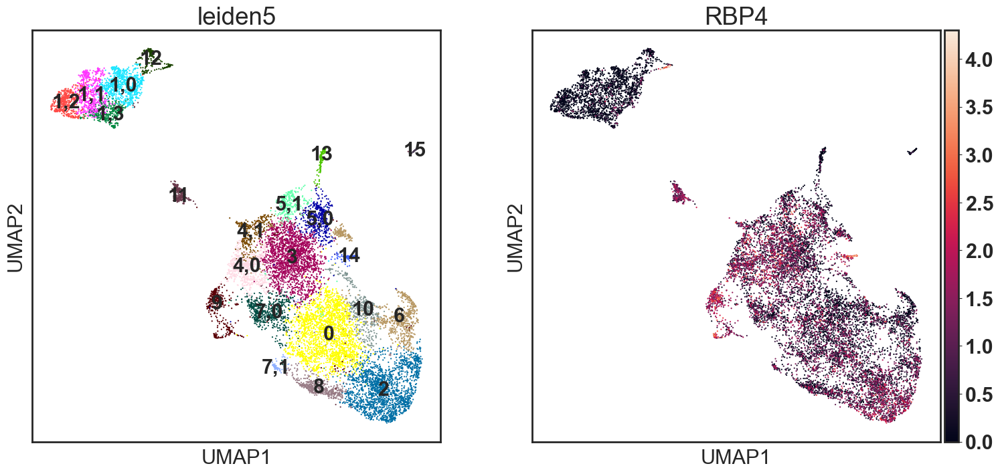

In [422]:
sc.pl.umap(adata, color=['leiden5','RBP4'], legend_loc = 'on data',size = 10)

## If you think some clusters are meaningless (i.e., they don't differ much with their neighbours), run the DE analysis as paired test with a reference

In [1623]:
SI = ['FABP2','APOC3','CD36','PCK2','SLC5A1','SLC2A2','SLC5A9','SLC2A5','SLC23A1','SLC2A9','SLC2A10','RBP2']

In [1842]:
g321=sc.tl.rank_genes_groups(adata, groupby='leiden6', groups =['9,2'],reference = '10',key_added='rank',method = 'wilcoxon',copy = True)
#, reference = '2,1'

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


(array([3.000e+00, 3.000e+00, 1.800e+01, 3.300e+01, 4.400e+01, 1.040e+02,
        1.810e+02, 2.010e+02, 1.590e+02, 3.040e+02, 5.410e+02, 0.000e+00,
        8.920e+02, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 4.000e+00, 7.000e+00,
        2.900e+01, 7.100e+01, 1.760e+02, 4.210e+02, 1.112e+03, 2.272e+03,
        4.507e+03, 2.881e+03, 1.815e+03, 1.012e+03, 5.310e+02, 6.210e+02,
        2.300e+02, 2.100e+02, 1.060e+02, 8.100e+01, 4.100e+01, 3.000e+01,
        1.600e+01, 9.000e+00, 4.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

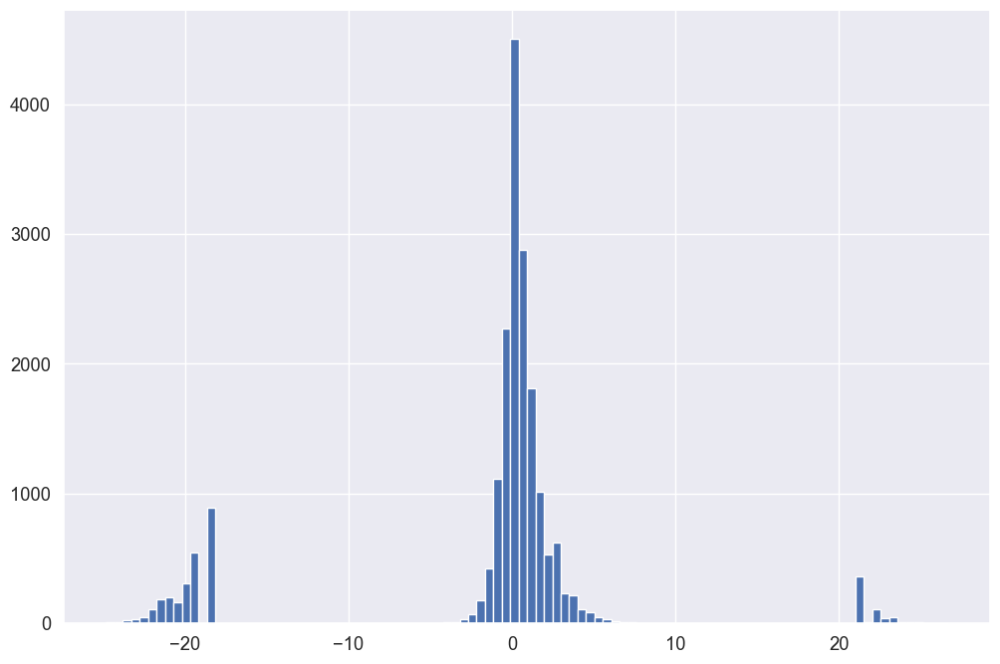

In [787]:
plt.hist(g321.uns['rank']['logfoldchanges'].astype('double'),bins = 100)

In [1843]:
log2foldmask = np.array(g321.uns['rank']['logfoldchanges'].astype('double')>4)
pvalmask = g321.uns['rank']['pvals'].astype('double')<0.001
additional = pd.DataFrame(g321.uns['rank']['names'][log2foldmask & pvalmask])

In [ ]:
pass_genes = pd.DataFrame()
for i in ['9,0','9,1','9,2']:
    log2foldmask = g321.uns['rank']['logfoldchanges'][i].astype('double')>6
    pvalmask = g321.uns['rank']['pvals'][i].astype('double')<0.001
    additional = pd.DataFrame({
        i: g321.uns['rank']['names'][i].astype('str')[log2foldmask & pvalmask]
    })
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

In [1844]:
#pass_genes[0:20]
additional#[additional.isin(['PROM1'])].dropna()

,"9,2"
0,XIST
1,LGALS4
2,TIMP1
3,RBP4
4,SLITRK6
5,SMIM22
6,NDUFA4L2
7,PHLDA2
8,S100P
9,GCG


In [901]:
additional.values.ravel()#.isin(['CD24']).any()#.isin(list(cc_genes.values.ravel()))

array(['RBP4', 'GCG', 'SCG2', 'OR51E1', 'SCG5', 'ENPP2', 'ETV1', 'UCN3',
       'PAX4', 'SST', 'RIMBP2', 'SLC38A11', 'NOV', 'INSM1', 'KLRC2',
       'MIR7-3HG', 'SCG3'], dtype=object)

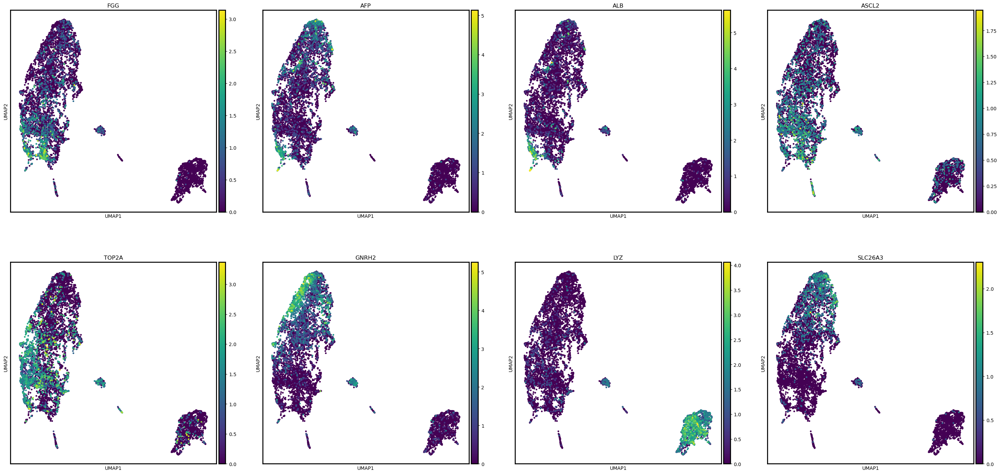

In [116]:
sc.pl.umap(adata, color=['FGG','AFP','ALB','ASCL2','TOP2A','GNRH2','LYZ','SLC26A3'], legend_loc = 'on data',size = 50)

## Subcluster

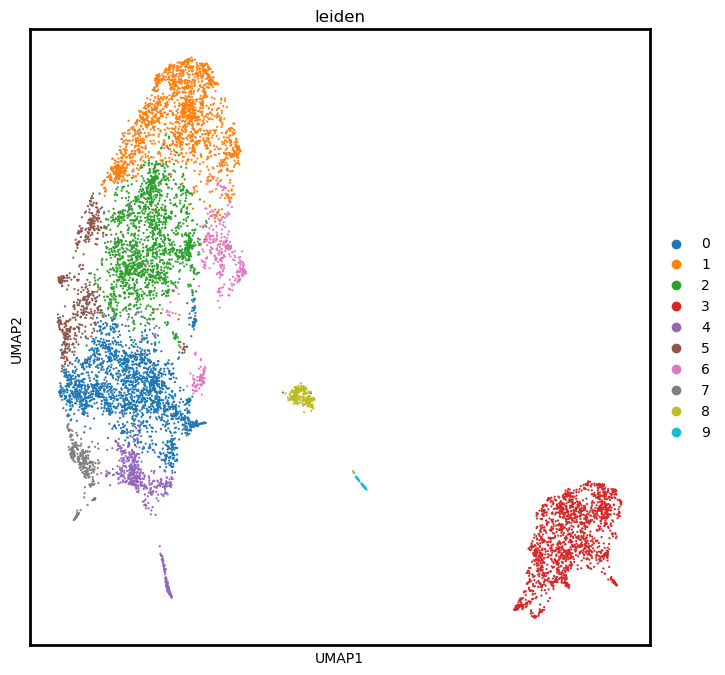

In [103]:
sc.pl.umap(adata, color = 'leiden',size = 10)

running Leiden clustering
    finished: found 12 clusters and added
    'leiden2', the cluster labels (adata.obs, categorical) (0:00:00)


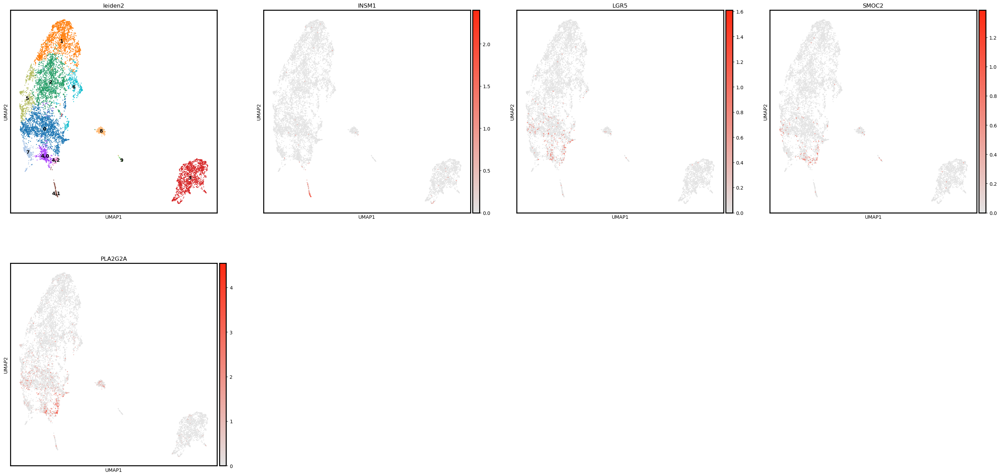

In [109]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata, restrict_to = ('leiden', ['4']), resolution = 0.2, key_added= 'leiden2')
sc.pl.umap(adata, color=['leiden2','INSM1','LGR5','SMOC2','PLA2G2A'],cmap = my_cmap, legend_loc = 'on data')
#go back to the DE section to make sure this subcluster make sense

running Leiden clustering
    finished: found 15 clusters and added
    'leiden3', the cluster labels (adata.obs, categorical) (0:00:00)


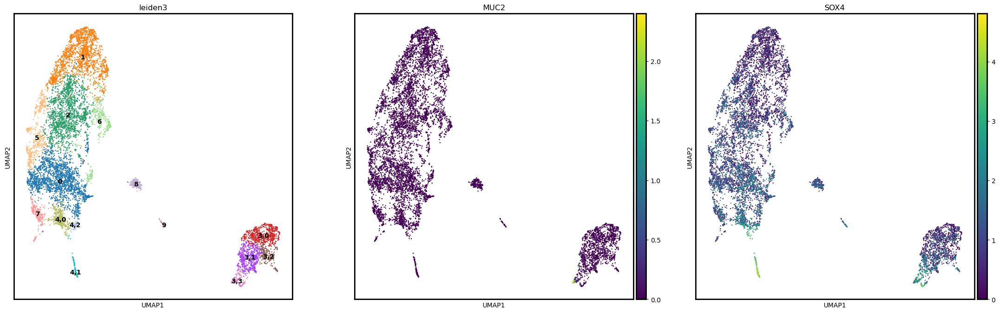

In [118]:
sc.tl.leiden(adata, restrict_to = ('leiden2', ['3']), resolution = 0.3, key_added= 'leiden3')
sc.pl.umap(adata, color=['leiden3','MUC2','SOX4'], legend_loc = 'on data')

running Leiden clustering
    finished: found 17 clusters and added
    'leiden4', the cluster labels (adata.obs, categorical) (0:00:00)


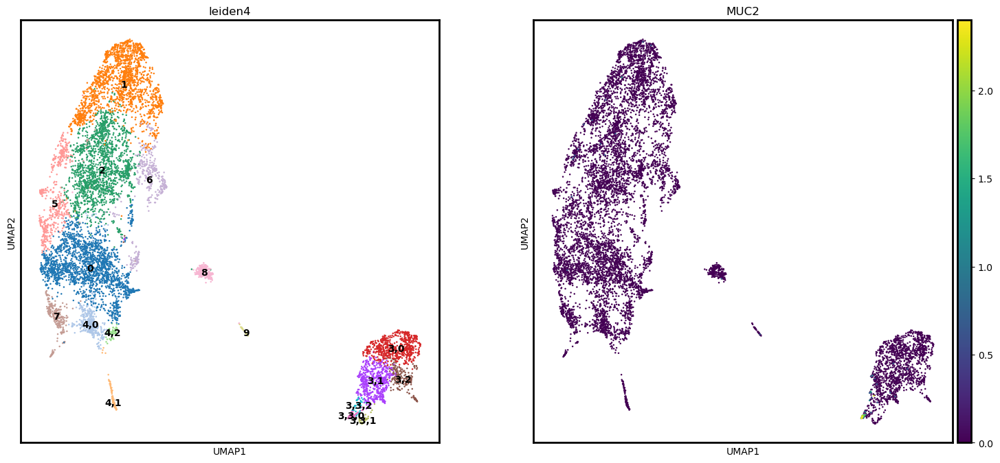

In [124]:
sc.tl.leiden(adata, restrict_to = ('leiden3', ['3,3']), resolution = 0.4, key_added= 'leiden4')
sc.pl.umap(adata, color=['leiden4','MUC2'], legend_loc = 'on data')

running Leiden clustering
    finished: found 20 clusters and added
    'leiden5', the cluster labels (adata.obs, categorical) (0:00:00)


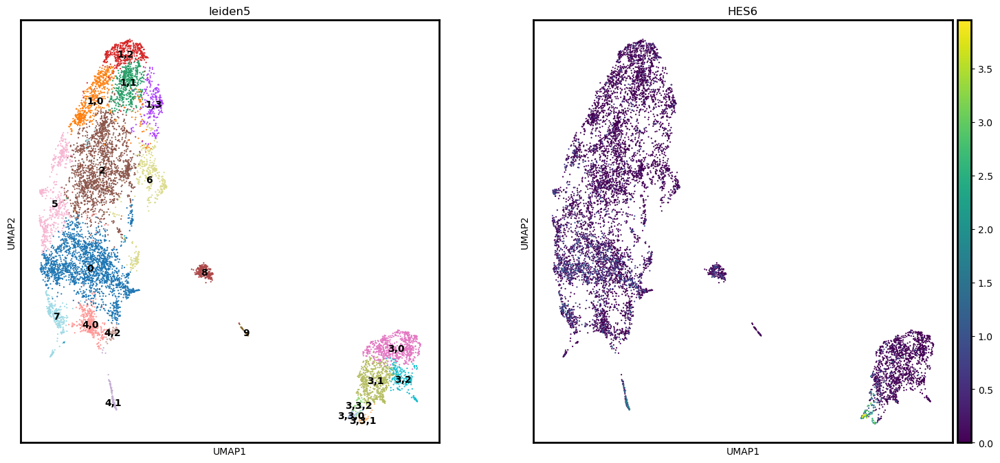

In [125]:
sc.tl.leiden(adata, restrict_to = ('leiden4', ['1']), resolution = 0.35, key_added= 'leiden5')
sc.pl.umap(adata, color=['leiden5','HES6'], legend_loc = 'on data',size = 10)

running Leiden clustering
    finished: found 20 clusters and added
    'leiden5', the cluster labels (adata.obs, categorical) (0:00:00)


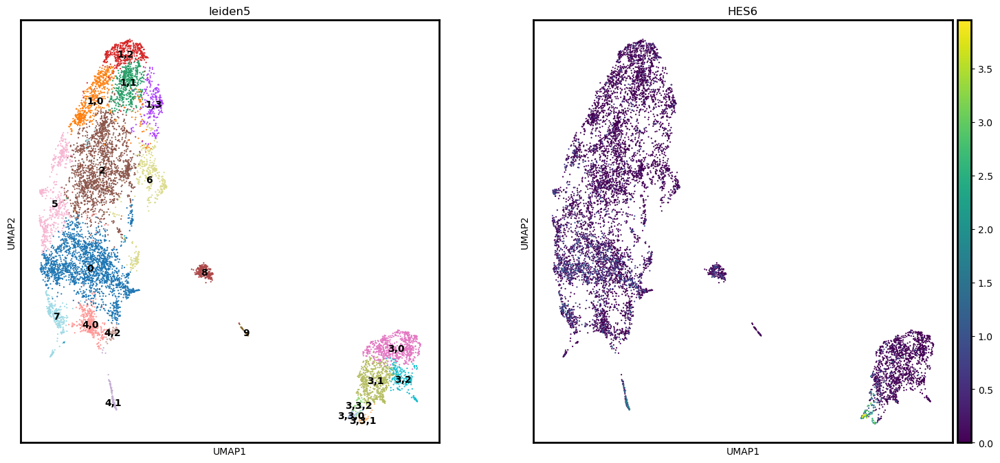

In [125]:
sc.tl.leiden(adata, restrict_to = ('leiden4', ['1']), resolution = 0.35, key_added= 'leiden5')
sc.pl.umap(adata, color=['leiden5','HES6'], legend_loc = 'on data',size = 10)

## Finalize the cluster

In [133]:
adata.obs['cluster_blind'] = adata.obs.groupby('leiden5').ngroup().astype('str')

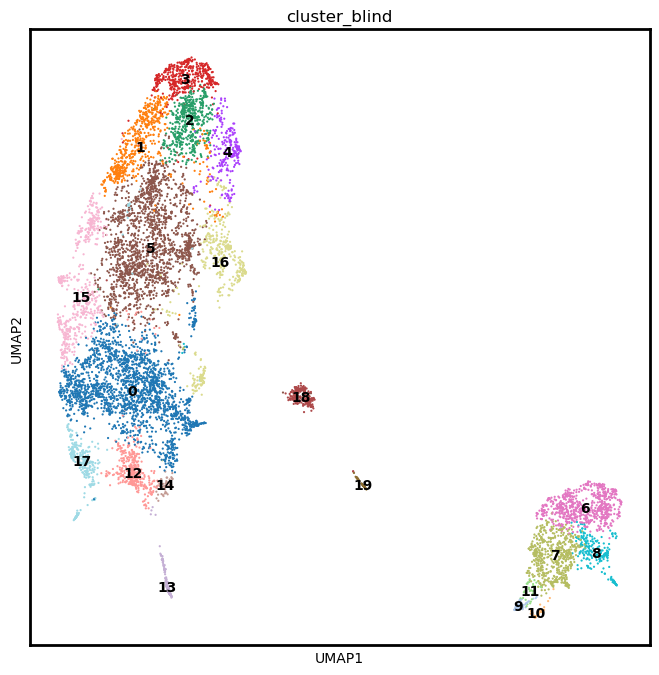

In [134]:
sc.pl.umap(adata, color=['cluster_blind'], legend_loc = 'on data',size = 10)

In [149]:
adata.obs['General Cell Types'] = adata.obs['cluster_blind']
adata.obs['General Cell Types'] = adata.obs['General Cell Types'].astype('str')

ISCLC = ['12','14']
TALC = ['17', '0', '15']
ECLC = ['1', '2', '3','4']
UDHT29 = ['6','7','8']
for c_id in set(adata.obs['cluster_blind']):
    if c_id in ISCLC:
        adata.obs = adata.obs.replace({'General Cell Types' : { c_id: 'Intestinal Stem like (ISCLC)'}})
    elif c_id in TALC:
        adata.obs = adata.obs.replace({'General Cell Types' : { c_id: 'Transit Amplifying like (TALC)'}})
    elif c_id in ECLC:
        adata.obs = adata.obs.replace({'General Cell Types' : { c_id: 'Enterocyte like (ECLC)'}})
    elif c_id in UDHT29:
        adata.obs = adata.obs.replace({'General Cell Types' : { c_id: 'Undifferentiated HT29 (U-HT29)'}})

adata.obs = adata.obs.replace({'General Cell Types' : { '5': 'Early Enterocyte like (Early ECLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '16': 'Early Enterocyte like (Early ECLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '18': 'LYZ+ Enterocyte like (LYZ+ ECLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '9': 'Goblet like (GCLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '10': 'Enteroendocrine like (EECLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '11': 'Secretory Progenitor like (SECPLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '13': 'Enteroendocrine like (EECLC)'}})
adata.obs = adata.obs.replace({'General Cell Types' : { '19': 'Fetal Genes-expressing (FGEC)'}})

adata.obs['General Cell Types'] = adata.obs['General Cell Types'].astype('category')

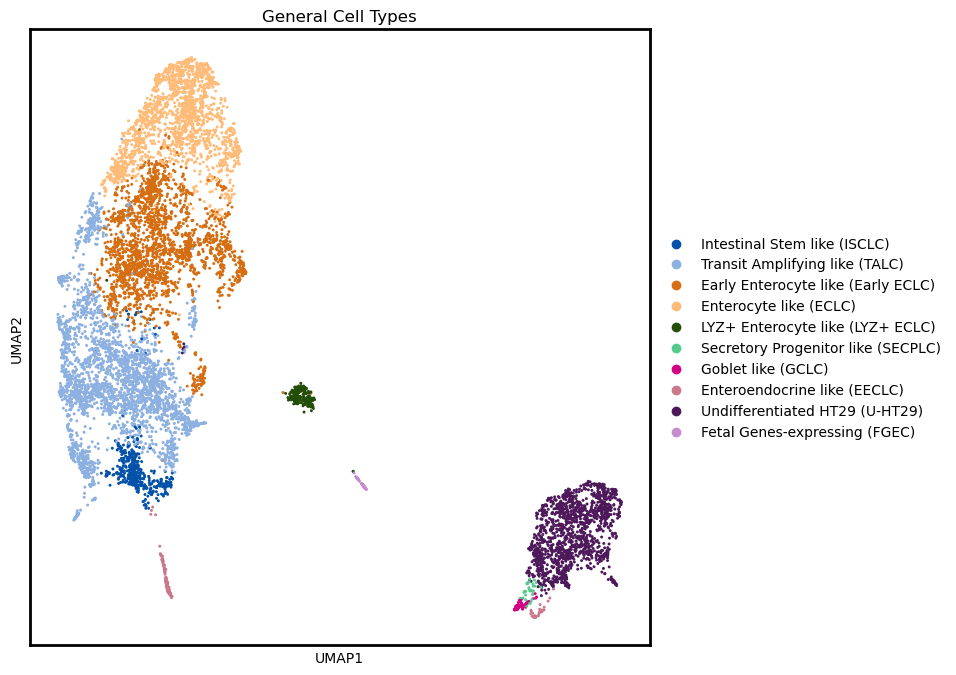

In [153]:
cat_order = ['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)',
             'Early Enterocyte like (Early ECLC)',
             'Enterocyte like (ECLC)',
             'LYZ+ Enterocyte like (LYZ+ ECLC)',
             'Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)',
             'Undifferentiated HT29 (U-HT29)',
            'Fetal Genes-expressing (FGEC)']
adata.obs['General Cell Types'].cat.reorder_categories(cat_order, inplace= True)
sc.pl.umap(adata, color=['General Cell Types'] ,size = 18, palette  = my_palette)

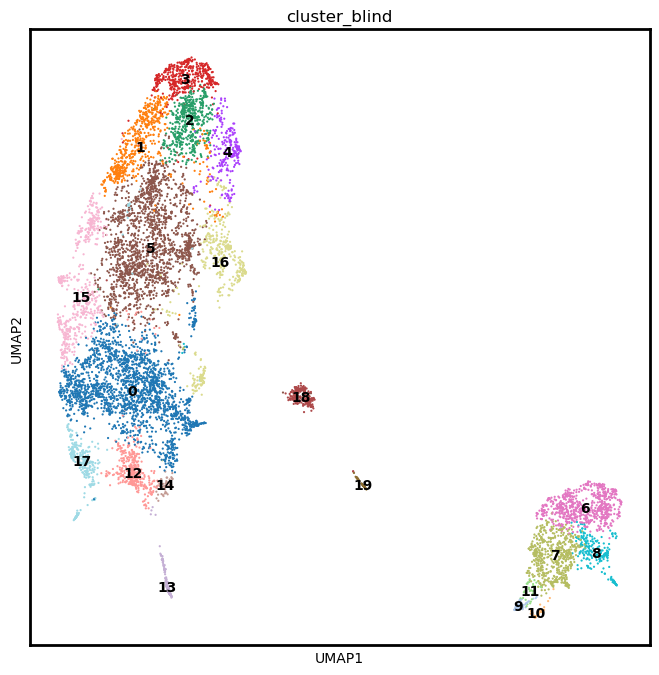

In [134]:
sc.pl.umap(adata, color=['cluster_blind'], legend_loc = 'on data',size = 10)

In [151]:
adata.obs['Detailed Cell Types'] = adata.obs['cluster_blind']
adata.obs['Detailed Cell Types'] = adata.obs['Detailed Cell Types'].astype('str')
adata.obs = adata.obs.replace({'Detailed Cell Types' : { 
    '0': 'Transit Amplifying like 1 (TALC 1)',
    '1': 'Enterocyte like 1 (ECLC 1)',
    '2': 'Enterocyte like 2 (ECLC 2)',
    '3': 'Enterocyte like 3 (ECLC 3)',
    '4': 'Enterocyte like 4 (ECLC 4)',
    '5': 'Early Enterocyte like 1 (Early ECLC 1)',
    '6': 'Undifferentiated HT29 1 (U-HT29 1)',    
    '7': 'Undifferentiated HT29 2 (U-HT29 2)',
    '8': 'Undifferentiated HT29 3 (U-HT29 3)',
    '9': 'Goblet like (GCLC)',
    '10': 'Enteroendocrine like 1 (EECLC 1)',
    '11': 'Secretory Progenitor like (SECPLC)',
    '12': 'Intestinal Stem like (ISCLC)',
    '13': 'Enteroendocrine like 2 (EECLC 2)',
    '14': 'Intestinal Stem like (ISCLC)',
    '15': 'Transit Amplifying like 2 (TALC 2)',
    '16': 'Early Enterocyte like 2 (Early ECLC 2)',
    '17': 'Transit Amplifying like 3 (TALC 3)',
    '18': 'LYZ+ Enterocyte like (LYZ+ ECLC)',
    '19': 'Fetal Genes-expressing (FGEC)'}})
adata.obs['Detailed Cell Types'] = adata.obs['Detailed Cell Types'].astype('category')

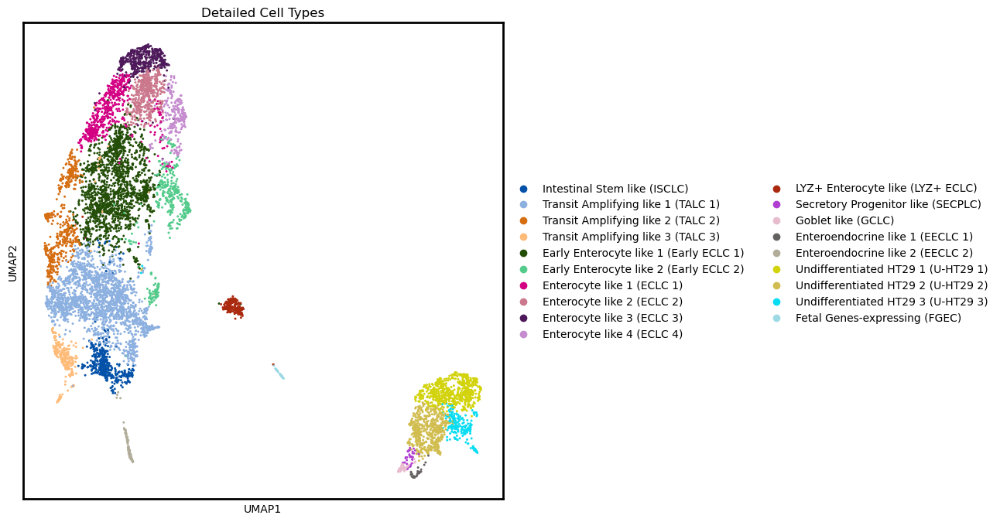

In [156]:
cat_order = ['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like 1 (TALC 1)',
             'Transit Amplifying like 2 (TALC 2)',
             'Transit Amplifying like 3 (TALC 3)',
             'Early Enterocyte like 1 (Early ECLC 1)',
             'Early Enterocyte like 2 (Early ECLC 2)',
             'Enterocyte like 1 (ECLC 1)',
             'Enterocyte like 2 (ECLC 2)',
             'Enterocyte like 3 (ECLC 3)',
             'Enterocyte like 4 (ECLC 4)',
             'LYZ+ Enterocyte like (LYZ+ ECLC)',
             'Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like 1 (EECLC 1)',
             'Enteroendocrine like 2 (EECLC 2)',
             'Undifferentiated HT29 1 (U-HT29 1)',
             'Undifferentiated HT29 2 (U-HT29 2)',
             'Undifferentiated HT29 3 (U-HT29 3)',
            'Fetal Genes-expressing (FGEC)']
adata.obs['Detailed Cell Types'].cat.reorder_categories(cat_order, inplace= True)
sc.pl.umap(adata, color=['Detailed Cell Types'] ,size = 18, palette  = my_palette)

In [73]:
plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color=['Detailed Cell Types'],
                 size =20, ncols = 1, cmap = my_cmap, return_fig = True,legend_fontsize = 'large', palette=twenty_palette)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('umap_detailed.png',dpi = 300,bbox_inches='tight')

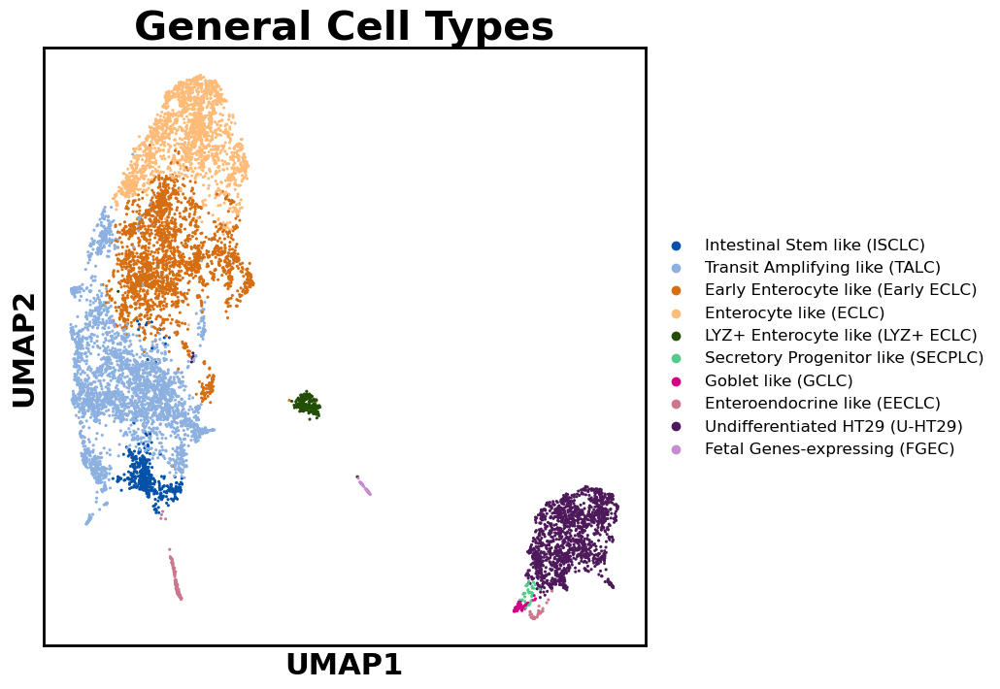

In [161]:
plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color=['General Cell Types'],
                 size =20, ncols = 1, cmap = my_cmap, return_fig = True,legend_fontsize = 'large', palette=my_palette)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('umap_general.png',dpi = 300,bbox_inches='tight')

In [111]:
plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color=['condition'],
                 size =20, ncols = 1, cmap = my_cmap, return_fig = True,legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('umap_batch.png',dpi = 300,bbox_inches='tight')

In [457]:
adata.obs['General Abbrv'] = adata.obs['cluster_blind']
adata.obs['General Abbrv'] = adata.obs['General Abbrv'].astype('str')

ISCLC = ['12','14']
TALC = ['17', '0', '15']
ECLC = ['1', '2', '3','4']
UDHT29 = ['6','7','8']
for c_id in set(adata.obs['cluster_blind']):
    if c_id in ISCLC:
        adata.obs = adata.obs.replace({'General Abbrv' : { c_id: 'ISCLC'}})
    elif c_id in TALC:
        adata.obs = adata.obs.replace({'General Abbrv' : { c_id: 'TALC'}})
    elif c_id in ECLC:
        adata.obs = adata.obs.replace({'General Abbrv' : { c_id: 'ECLC'}})
    elif c_id in UDHT29:
        adata.obs = adata.obs.replace({'General Abbrv' : { c_id: 'U-HT29'}})

adata.obs = adata.obs.replace({'General Abbrv' : { '5': 'Early ECLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '16': 'Early ECLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '18': 'LYZ+ ECLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '9': 'GCLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '10': 'EECLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '11': 'SECPLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '13': 'EECLC'}})
adata.obs = adata.obs.replace({'General Abbrv' : { '19': 'FGEC'}})

adata.obs['General Abbrv'] = adata.obs['General Abbrv'].astype('category')

In [464]:
del adata.uns['General Abbrv_colors']

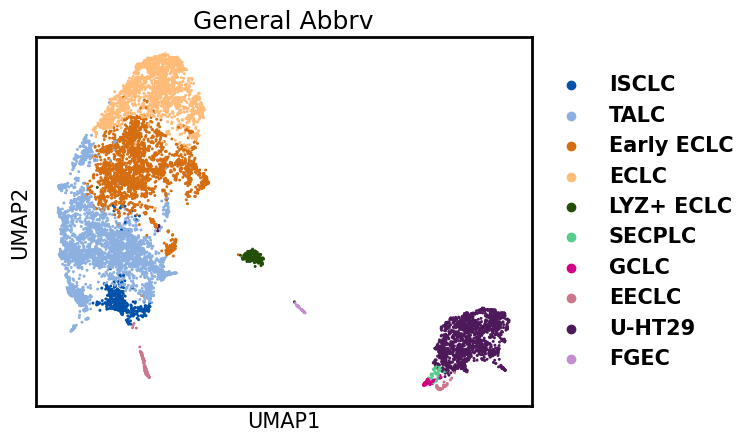

In [465]:
cat_order = ['ISCLC',
             'TALC',
             'Early ECLC',
             'ECLC',
             'LYZ+ ECLC',
             'SECPLC',
             'GCLC',
             'EECLC',
             'U-HT29',
            'FGEC']
adata.obs['General Abbrv'] = adata.obs['General Abbrv'].cat.reorder_categories(cat_order)
sc.pl.umap(adata, color=['General Abbrv'] ,size = 18, palette  = my_palette)

In [467]:
adata.obs['Detailed Abbrv'] = adata.obs['cluster_blind']
adata.obs['Detailed Abbrv'] = adata.obs['Detailed Abbrv'].astype('str')
adata.obs = adata.obs.replace({'Detailed Abbrv' : { 
    '0': 'TALC 1',
    '1': 'ECLC 1',
    '2': 'ECLC 2',
    '3': 'ECLC 3',
    '4': 'ECLC 4',
    '5': 'Early ECLC 1',
    '6': 'U-HT29 1',    
    '7': 'U-HT29 2',
    '8': 'U-HT29 3',
    '9': 'GCLC',
    '10': 'EECLC 1',
    '11': 'SECPLC',
    '12': 'ISCLC',
    '13': 'EECLC 2',
    '14': 'ISCLC',
    '15': 'TALC 2',
    '16': 'Early ECLC 2',
    '17': 'TALC 3',
    '18': 'LYZ+ ECLC',
    '19': 'FGEC'}})
adata.obs['Detailed Abbrv'] = adata.obs['Detailed Abbrv'].astype('category')

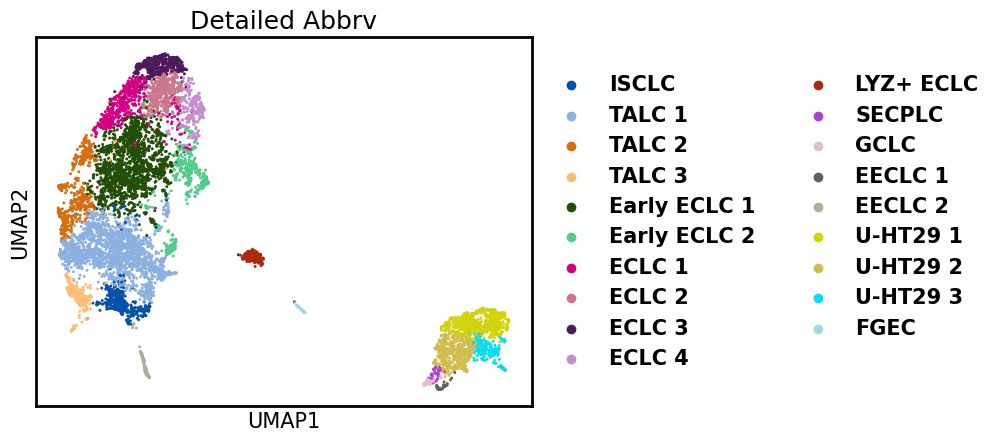

In [469]:
cat_order = ['ISCLC',
             'TALC 1',
             'TALC 2',
             'TALC 3',
             'Early ECLC 1',
             'Early ECLC 2',
             'ECLC 1',
             'ECLC 2',
             'ECLC 3',
             'ECLC 4',
             'LYZ+ ECLC',
             'SECPLC',
             'GCLC',
             'EECLC 1',
             'EECLC 2',
             'U-HT29 1',
             'U-HT29 2',
             'U-HT29 3',
            'FGEC']
adata.obs['Detailed Abbrv'] = adata.obs['Detailed Abbrv'].cat.reorder_categories(cat_order)
sc.pl.umap(adata, color=['Detailed Abbrv'] ,size = 18, palette  = my_palette)

In [470]:
adata.write('Processed_control_only.h5ad')

## Fit Negative binomial distribution on CCLE RNA seq

In [313]:
ccle = pd.read_csv('F:/GSE185224/CCLE_RNAseq_reads.csv',index_col = 0)

In [369]:
table = np.round(ccle.loc[['ACH-000003','ACH-000552'],:])

In [370]:
table = table.transpose()

In [371]:
table.index = [table.index[i].split(' ')[0] for i in range(0,len(table.index))]

In [372]:
table.columns = ['CACO2','HT29']

In [378]:
table['Diff'] = table['CACO2'] - table['HT29']

In [379]:
unknown_mask = [gene.startswith('ENSG0000')==False for gene in table.index]
table = table.iloc[unknown_mask,:]

In [380]:
#CACO2 sig
zz = pd.DataFrame(table['Diff'][table['Diff']>0])

In [381]:
import statsmodels.discrete.discrete_model as smds

In [382]:
X = np.ones_like(zz)
z = smds.NegativeBinomial(zz,X).fit(start_params = [1,1])

Optimization terminated successfully.
         Current function value: 6.722332
         Iterations: 18
         Function evaluations: 19
         Gradient evaluations: 19


In [383]:
mu = np.exp(z.params[0])
p = 1/(1+np.exp(z.params[0])*z.params[1])
n = np.exp(z.params[0])*p/(1-p)

In [384]:
CACO2_cut = sp.stats.nbinom.ppf(0.95, n, p)

In [385]:
CACO2_sig = table['Diff'][table['Diff']>=CACO2_cut].index

In [386]:
#HT29 sig
zzz = np.abs(pd.DataFrame(table['Diff'][table['Diff']<0]))

In [387]:
X = np.ones_like(zzz)
z = smds.NegativeBinomial(zzz,X).fit(start_params = [1,1])
print(z.summary())

Optimization terminated successfully.
         Current function value: 5.708026
         Iterations: 16
         Function evaluations: 17
         Gradient evaluations: 17
                     NegativeBinomial Regression Results                      
Dep. Variable:                   Diff   No. Observations:                 9492
Model:               NegativeBinomial   Df Residuals:                     9491
Method:                           MLE   Df Model:                            0
Date:                Sat, 25 Nov 2023   Pseudo R-squ.:               3.209e-11
Time:                        21:51:27   Log-Likelihood:                -54181.
converged:                       True   LL-Null:                       -54181.
Covariance Type:            nonrobust   LLR p-value:                       nan
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.1524      0.022    28

In [389]:
mu = np.exp(z.params[0])
p = 1/(1+np.exp(z.params[0])*z.params[1])
n = np.exp(z.params[0])*p/(1-p)

In [390]:
HT29_cut = sp.stats.nbinom.ppf(0.95, n, p)

In [391]:
HT29_sig = table['Diff'][table['Diff']<=-HT29_cut].index
HT29_sig

Index(['NIPAL3', 'LASP1', 'AK2', 'HOXA11', 'ITGA3', 'RHBDF1', 'ST3GAL1',
       'CSDE1', 'SLC38A5', 'VSIG2',
       ...
       'TAF15', 'CD24', 'AL365181.3', 'AFAP1-AS1', 'MLLT6', 'ARHGAP23',
       'CISD3', 'ACACA', 'FP671120.6', 'FP236383.5'],
      dtype='object', length=411)

In [392]:
CH_marker = dict()
CH_marker['HT29 Signature'] = HT29_sig
CH_marker['CACO2 Signature'] = CACO2_sig

In [393]:
CH_marker_df = pd.DataFrame({'HT29 Signature':HT29_sig})
i = pd.DataFrame({'CACO2 Signature':CACO2_sig})
CH_marker_df = pd.concat([CH_marker_df, i], ignore_index=False, axis=1)

In [394]:
CH_marker_df.to_excel('Caco_HT29_markers.xlsx')

In [432]:
plt.close()
plt.rcParams['figure.figsize'] = [2,8]
#sns.reset_orig()
CH_annotation = sc.tl.marker_gene_overlap(adata, CH_marker, key='rank_2',normalize='reference')
ax = sns.heatmap(CH_annotation.T, cbar=True, annot=False, cbar_kws = {'ticks': [], 'label': 'Similarity'})
sns.set(font_scale=1.2)
#plt.yticks(np.arange(2)+0.5,('HT29 Signatures','Caco-2 Signatures',),fontsize="20")
plt.savefig('id_origin.png',bbox_inches='tight')

## Figures

### An overall heatmap

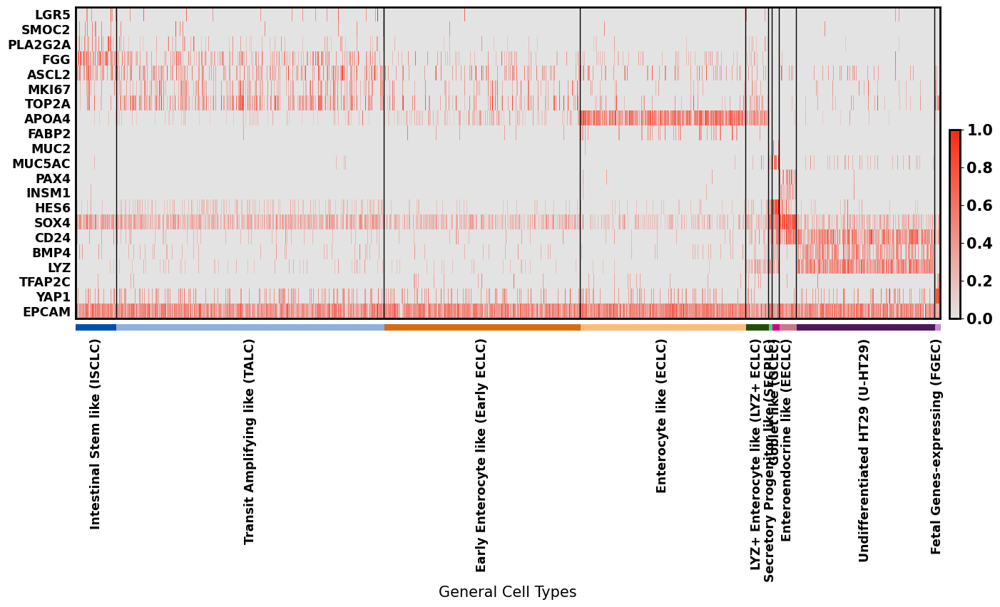

In [259]:
import matplotlib
matplotlib.rc_file_defaults()
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
Z = sc.pl.heatmap(adata, ['LGR5','SMOC2','PLA2G2A','FGG','ASCL2','MKI67','TOP2A','APOA4','FABP2','MUC2','MUC5AC','PAX4','INSM1','HES6','SOX4','CD24','BMP4','LYZ','TFAP2C','YAP1','EPCAM'],
                  groupby='General Cell Types',figsize = [16,6], swap_axes=True, vmax =1, standard_scale='var',cmap = my_cmap,save ='id_marker_rep.png')

### composition pie chart

In [312]:
import matplotlib.patheffects as path_effects
data = adata.obs['General Cell Types'].value_counts(normalize=True).reindex(adata.obs['General Cell Types'].cat.categories)
explode = [0, 0, 0, 0, 0, 1, 1, 0, 0, 1]  # Exploded slices are marked with non-zero values

patches, texts, autotexts = plt.pie(data, autopct='%1.2f%%', rotatelabels=True, colors=my_palette, shadow=False, radius=1.3)

# Custom adjustments for the labels of exploded slices
for i, (patch, text, autotext) in enumerate(zip(patches, texts, autotexts)):
    if i== 5:  # Check if the slice is exploded
        # Compute the angle and apply the adjustment
        ang = (patch.theta2 + patch.theta1) / 2
        x = 1.2 * np.cos(np.deg2rad(ang))
        y = 1.6 * np.sin(np.deg2rad(ang))

        # Set the new position for the label
        autotext.set_position((x, y))
    elif i == 6:
        ang = (patch.theta2 + patch.theta1) / 2
        x = 1.8 * np.cos(np.deg2rad(ang))
        y = 1.4 * np.sin(np.deg2rad(ang))

        # Set the new position for the label
        autotext.set_position((x, y))
    elif i == 7:
        ang = (patch.theta2 + patch.theta1) / 2
        x = 1 * np.cos(np.deg2rad(ang))
        y = 1 * np.sin(np.deg2rad(ang))

        # Set the new position for the label
        autotext.set_position((x, y))
    elif i == 10:
        ang = (patch.theta2 + patch.theta1) / 2
        x = 1.5 * np.cos(np.deg2rad(ang))
        y = 1.5 * np.sin(np.deg2rad(ang))

        # Set the new position for the label
        autotext.set_position((x, y))


plt.setp(autotexts, size=10, weight="bold")
stroke_effect = [path_effects.withStroke(linewidth=3, foreground='white')]
for autotext in autotexts:
    autotext.set_path_effects(stroke_effect)
plt.savefig('TW_composition.png',dpi = 300,bbox_inches='tight')

### Briefly calculate the DE in each group

In [8]:
def DE_to_df(_adata, rank_key, _padj_thresh=0.05, _logfc_thresh=1):
    def process_genes(i, direction):
        _log2foldmask = (_adata.uns[rank_key]['logfoldchanges'][i].astype('double') >= _logfc_thresh) if direction == "up" else (_adata.uns[rank_key]['logfoldchanges'][i].astype('double') <= -_logfc_thresh)
        _pvalmask = _adata.uns[rank_key]['pvals_adj'][i].astype('double') <= _padj_thresh
        _additional = pd.DataFrame({
            i: _adata.uns[rank_key]['names'][i].astype('str')[_log2foldmask & _pvalmask],
            'logfoldchanges_'+i: np.abs(_adata.uns[rank_key]['logfoldchanges'][i].astype('double')[_log2foldmask & _pvalmask])
        })
        _ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in _additional[i]]
        _mt_gene_mask = [gene.startswith('MT-') for gene in _additional[i]]
        if len(_ribo_gene_mask)>0 and len(_mt_gene_mask)>0:
            _drop_id = np.array(np.array(_ribo_gene_mask) | np.array(_mt_gene_mask))
            _additional = _additional.sort_values(by='logfoldchanges_'+i, ascending=False)
            _additional = _additional.iloc[_drop_id==False, :].reset_index(drop=True)
        return _additional
    _pass_genes_up = pd.DataFrame()
    _pass_genes_down = pd.DataFrame()
    for i in set(_adata.uns[rank_key]['pvals_adj'].dtype.names):
        _pass_genes_up = pd.concat([_pass_genes_up, process_genes(i, "up")[i]], ignore_index=False, axis=1)
        _pass_genes_down = pd.concat([_pass_genes_down, process_genes(i, "down")[i]], ignore_index=False, axis=1)
    return _pass_genes_up, _pass_genes_down

In [9]:
sc.tl.rank_genes_groups(adata, groupby='General Cell Types', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:15)


In [19]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='rank', _padj_thresh = 0.01, _logfc_thresh = 2)

In [12]:
pass_genes_up.to_csv('general_celltype_DE.csv')

In [13]:
sc.tl.rank_genes_groups(adata, groupby='Detailed Cell Types', key_added='rank_2',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank_2']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:16)


In [9]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='rank_2', _padj_thresh = 0.01, _logfc_thresh = 2)

In [192]:
pass_genes_up.to_csv('detailed_celltype_DE.csv')

In [201]:
sc.tl.rank_genes_groups(adata, groupby='Detailed Cell Types', groups = ['Enterocyte like 1 (ECLC 1)',
    'Enterocyte like 2 (ECLC 2)',
    'Enterocyte like 3 (ECLC 3)',
    'Enterocyte like 4 (ECLC 4)',
    'Early Enterocyte like 1 (Early ECLC 1)',
    'Early Enterocyte like 2 (Early ECLC 2)',
              'LYZ+ Enterocyte like (LYZ+ ECLC)'], key_added='rank_3',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank_3']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)


In [202]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='rank_3', _padj_thresh = 0.01, _logfc_thresh = 2)

### Show our DE in our cells

In [34]:
TW_DE_reordered = pd.read_csv('F:/Transwell/TW_DE_reordered.csv',index_col = 0)

In [44]:
from scipy.cluster.hierarchy import linkage, leaves_list
import matplotlib
matplotlib.rc_file_defaults()
plt.close()
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
names = ['ISC','TA','Goblet','EEC']
#define the important gene that audience might interested
imp_genes = dict()
imp_genes['ISC'] = ['LGR5', 'ASCL2','SMOC2','MSI1','OLFM4']
imp_genes['TA'] = ['TOP2A','DNMT1','BLM','FEN1','PCNA','UHRF1','MCM10','BRCA1','TYMS','RAD51AP1','CHEK1','WDHD1','CDT1','HELLS','RFC3','RMI2','RFC4','XRCC2','FANCA','CDC6','POLE2','CDK1','MCM3','TIMELESS','MCM4','MCM5','DNA2','MCM6','MCM2']
imp_genes['Sec. Progenitor'] = ['HES6','SOX4','HOPX','ATOH1','MEX3A']
imp_genes['Goblet'] = ['MUC2','MUC5AC','FCGBP','SOX4','SPDEF', 'FCGBP','TFF3']
imp_genes['EEC'] = ['CHGA','CHGGB','INSM1','PAX4','PAX6']


plt.rcParams.update(plt.rcParamsDefault)
our_names =  ['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)']

adata_df = pd.DataFrame(adata.X.A)
adata_df.index = adata.obs_names
adata_df.columns = adata.var_names
adata_df['General Cell Types'] = adata.obs['General Cell Types']
adata_df['Detailed Cell Types'] = adata.obs['Detailed Cell Types']

color = np.array(adata_df['Detailed Cell Types'].values.ravel())

for j in range(0, len(color)):
    id = np.where(adata.obs['Detailed Cell Types'].cat.categories == color[j])[0][0]
    color[j]=twenty_palette[id]
adata_df['color'] = color

In [47]:
for i in range(0, len(names)):
    # Slice data for clustering
    adata_slice = adata_df.loc[adata_df['General Cell Types'] == our_names[i], :]
    adata_slice = adata_slice.sort_values(by='Detailed Cell Types')
    
    col_colors = adata_slice['color'].tolist()
    
    del adata_slice['General Cell Types']
    del adata_slice['Detailed Cell Types']
    del adata_slice['color']
    
    ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_slice.columns]
    adata_slice = adata_slice.loc[:,np.array(ribo_gene_mask)==False]
    
    
    # Plot the clustered heatmap
    clustergrid = sns.clustermap(adata_slice[TW_DE_reordered.iloc[:,i].dropna().tolist()].T, figsize=(5, len(TW_DE_reordered.iloc[:,i].dropna().tolist())/5), linewidths=0,
                                 colors_ratio=(0.05, 0.05), yticklabels=True, xticklabels=False, cmap=my_cmap, 
                                 col_colors=col_colors, 
                                 col_cluster=False, row_cluster=False, standard_scale=0,
                                 cbar_kws={'label': '', 'location': "left"})

    # Adjustments for the plot
    for a in clustergrid.ax_col_dendrogram.collections:
        a.set_linewidth(2)
    clustergrid.ax_cbar.set_position([0, 0.2, 0.03, 0.3])

    axs = clustergrid.fig.get_axes()
    for ax in axs:
        ax.set_xlabel('')
    for lab in axs[4].get_yticklabels():
        text = lab.get_text()
        if text in imp_genes[names[i]]:
            lab.set_weight('bold')
            lab.set_color('red')

    # Save the plot
    #plt.show()
    plt.savefig(our_names[i] + '_TW_signature_in_TW.png', dpi=300, bbox_inches='tight')

### Plot human markers with our cells

In [10]:
human_DE = pd.read_csv('human_DE.csv')

In [61]:
from scipy.cluster.hierarchy import linkage, leaves_list
import matplotlib
matplotlib.rc_file_defaults()
plt.close()
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
names = ['ISC','TA','Sec. Progenitor','Goblet','EEC']
#define the important gene that audience might interested
imp_genes = dict()
imp_genes['ISC'] = ['LGR5', 'ASCL2','SMOC2','MSI1','OLFM4']
imp_genes['TA'] = ['TOP2A','DNMT1','BLM','FEN1','PCNA','UHRF1','MCM10','BRCA1','TYMS','RAD51AP1','CHEK1','WDHD1','CDT1','HELLS','RFC3','RMI2','RFC4','XRCC2','FANCA','CDC6','POLE2','CDK1','MCM3','TIMELESS','MCM4','MCM5','DNA2','MCM6','MCM2']
imp_genes['Sec. Progenitor'] = ['HES6','SOX4','HOPX','ATOH1','MEX3A']
imp_genes['Goblet'] = ['MUC2','MUC5AC','FCGBP','SOX4','SPDEF', 'FCGBP','TFF3']
imp_genes['EEC'] = ['CHGA','CHGGB','INSM1','PAX4','PAX6']


plt.rcParams.update(plt.rcParamsDefault)
our_names =  ['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)',
             'Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)']
groups = [[0,1],[2,4],[5,6],[7,8],[9,10]] #ISC TA SECP GOBLET EEC
row_color = [['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3']]
adata_df = pd.DataFrame(adata.X.A)
adata_df.index = adata.obs_names
adata_df.columns = adata.var_names
adata_df['General Cell Types'] = adata.obs['General Cell Types']
adata_df['Detailed Cell Types'] = adata.obs['Detailed Cell Types']

color = np.array(adata_df['Detailed Cell Types'].values.ravel())
for j in range(0, len(color)):
    id = np.where(adata.obs['Detailed Cell Types'].cat.categories == color[j])[0][0]
    color[j]=twenty_palette[id]
adata_df['color'] = color

human_gene_reordered = dict()
# Function to perform hierarchical clustering and return the ordered rows
def cluster_cols(data):
    Z = linkage(data.T, method='average')  # Note the transpose (.T) to cluster columns
    order = leaves_list(Z)
    return data.iloc[:, order]

# Iterate over each cell type group, cluster within each group, and plot
for i in range(0, len(names)):
    selected_columns = [human_DE.iloc[:, idx].dropna() for idx in groups[i]]
    common_elements = set.intersection(*map(set, selected_columns))
    unique_elements = [set(column) - common_elements for column in selected_columns]

    # Create the combined list
    human_DE_list = list(common_elements)
    row_colors = [row_color[i][0] for _ in common_elements]  # Common elements color
    for idx, unique in enumerate(unique_elements):
        human_DE_list.extend(list(unique))
        row_colors.extend([row_color[i][idx+1] for _ in unique])
    human_DE_list = pd.Series(human_DE_list)
    # Additional columns if they are not in the original dataframe
    adata_df[human_DE_list[~human_DE_list.isin(adata_df.columns)].tolist()] = np.zeros([adata_df.shape[0], len(human_DE_list[~human_DE_list.isin(adata_df.columns)].tolist())])
    

    # Slice data for clustering
    adata_slice = adata_df.loc[adata_df['General Cell Types'] == our_names[i], :]
    adata_slice = adata_slice.sort_values(by='Detailed Cell Types')
    
    col_colors = adata_slice['color'].tolist()
    
    del adata_slice['General Cell Types']
    del adata_slice['Detailed Cell Types']
    del adata_slice['color']

    # Split human_DE_list into common and unique parts
    common_genes = list(common_elements)
    unique_genes = [gene for gene in human_DE_list if gene not in common_genes]

    # Cluster common genes
    common_clustered = cluster_cols(adata_slice[common_genes]) if common_genes else pd.DataFrame()

    # Cluster unique genes in each column separately
    unique_clustered = pd.DataFrame()
    for unique_set in unique_elements:
        unique_set_clustered = cluster_cols(adata_slice[list(unique_set)]) if unique_set else pd.DataFrame()
        unique_clustered = pd.concat([unique_clustered, unique_set_clustered], axis=1)

    # Combine clustered genes in order
    adata_slice_clustered = pd.concat([common_clustered, unique_clustered], axis=1)
    
    ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_slice_clustered.columns]
    adata_slice_clustered = adata_slice_clustered.loc[:,np.array(ribo_gene_mask)==False]
    row_colors = pd.Series(row_colors)[np.array(ribo_gene_mask)==False].to_list()
    
    
    human_gene_reordered[names[i]] = adata_slice_clustered.columns
    
    # Plot the clustered heatmap
    clustergrid = sns.clustermap(adata_slice_clustered.T, figsize=(5, len(human_DE_list)/5), linewidths=0,
                                 colors_ratio=(0.05, 0.01), yticklabels=True, xticklabels=False, cmap=my_cmap, 
                                 col_colors=col_colors, row_colors=row_colors,
                                 col_cluster=False, row_cluster=False, standard_scale=0,
                                 cbar_kws={'label': '', 'location': "left"})

    # Adjustments for the plot
    for a in clustergrid.ax_col_dendrogram.collections:
        a.set_linewidth(2)
    clustergrid.ax_cbar.set_position([0, 0.2, 0.03, 0.3])

    axs = clustergrid.fig.get_axes()
    for ax in axs:
        ax.set_xlabel('')
    for lab in axs[4].get_yticklabels():
        text = lab.get_text()
        if text in imp_genes[names[i]]:
            lab.set_weight('bold')
            lab.set_color('red')

    # Save the plot
    #plt.show()
    plt.savefig(our_names[i] + '_human_signature_in_TW.png', dpi=300, bbox_inches='tight')


### Plot fetal markers with our cells

In [29]:
fetal_DE = pd.read_csv('fetal_DE.csv',index_col = 0)

In [30]:
from scipy.cluster.hierarchy import linkage, leaves_list
import matplotlib
matplotlib.rc_file_defaults()
plt.close()
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
names = ['ISC','Goblet','EEC']
#define the important gene that audience might interested
imp_genes = dict()
imp_genes['ISC'] = ['LGR5', 'ASCL2','SMOC2','MSI1','OLFM4']
imp_genes['Goblet'] = ['MUC2','MUC5AC','FCGBP','SOX4','SPDEF', 'FCGBP','TFF3']
imp_genes['EEC'] = ['CHGA','CHGGB','INSM1','PAX4','PAX6']


plt.rcParams.update(plt.rcParamsDefault)
our_names =  ['Intestinal Stem like (ISCLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)']
groups = [[0,1],[2,4],[5,6],[7,8],[9,10]] #ISC TA SECP GOBLET EEC
row_color = [['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3'],['#a877d6','#68b93c','#4c9bd3']]
adata_df = pd.DataFrame(adata.X.A)
adata_df.index = adata.obs_names
adata_df.columns = adata.var_names
adata_df['General Cell Types'] = adata.obs['General Cell Types']
adata_df['Detailed Cell Types'] = adata.obs['Detailed Cell Types']

color = np.array(adata_df['Detailed Cell Types'].values.ravel())
for j in range(0, len(color)):
    id = np.where(adata.obs['Detailed Cell Types'].cat.categories == color[j])[0][0]
    color[j]=twenty_palette[id]
adata_df['color'] = color

fetal_gene_reordered = dict()
# Function to perform hierarchical clustering and return the ordered rows
def cluster_cols(data):
    Z = linkage(data.T, method='average')  # Note the transpose (.T) to cluster columns
    order = leaves_list(Z)
    return data.iloc[:, order]

# Iterate over each cell type group, cluster within each group, and plot
for i in range(0, len(names)):
    fetal_DE_list = pd.Series(fetal_DE.iloc[:, i].dropna().tolist())
    # Additional columns if they are not in the original dataframe
    adata_df[fetal_DE_list[~fetal_DE_list.isin(adata_df.columns)].tolist()] = np.zeros([adata_df.shape[0], len(fetal_DE_list[~fetal_DE_list.isin(adata_df.columns)].tolist())])
    

    # Slice data for clustering
    adata_slice = adata_df.loc[adata_df['General Cell Types'] == our_names[i], :]
    adata_slice = adata_slice.sort_values(by='Detailed Cell Types')
    
    col_colors = adata_slice['color'].tolist()
    
    del adata_slice['General Cell Types']
    del adata_slice['Detailed Cell Types']
    del adata_slice['color']

    adata_slice_clustered = cluster_cols(adata_slice[fetal_DE_list])
    
    ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_slice_clustered.columns]
    adata_slice_clustered = adata_slice_clustered.loc[:,np.array(ribo_gene_mask)==False]
    
    fetal_gene_reordered[names[i]] = adata_slice_clustered.columns
    
    # Plot the clustered heatmap
    clustergrid = sns.clustermap(adata_slice_clustered.T, figsize=(5, len(fetal_DE_list)/5), linewidths=0,
                                 colors_ratio=(0.05, 0.01), yticklabels=True, xticklabels=False, cmap=my_cmap, 
                                 col_colors=col_colors, 
                                 col_cluster=False, row_cluster=False, standard_scale=0,
                                 cbar_kws={'label': '', 'location': "left"})

    # Adjustments for the plot
    for a in clustergrid.ax_col_dendrogram.collections:
        a.set_linewidth(2)
    clustergrid.ax_cbar.set_position([0, 0.2, 0.03, 0.3])

    axs = clustergrid.fig.get_axes()
    for ax in axs:
        ax.set_xlabel('')
    for lab in axs[3].get_yticklabels():
        text = lab.get_text()
        if text in imp_genes[names[i]]:
            lab.set_weight('bold')
            lab.set_color('red')

    # Save the plot
    #plt.show()
    plt.savefig(our_names[i] + '_fetal_signature_in_TW.png', dpi=300, bbox_inches='tight')


#### for legend

In [75]:
pd.DataFrame(adata.obs['Detailed Cell Types'].value_counts(normalize = True).reindex(adata.obs['Detailed Cell Types'].cat.categories)).T.plot.bar(stacked=True,color = adata.uns['Detailed Cell Types_colors']).legend(loc='center left',bbox_to_anchor=(1.0, 0.5),fontsize = 15)
plt.savefig('detailed_bar_for_legend.png',dpi = 300,bbox_inches='tight')

In [68]:
import matplotlib.patches as mpatches
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
colors = ['#a877d6', '#68b93c', '#4c9bd3']
labels = ['Common', 'SI', 'C']

# Create a list of patches to add to the legend
patches = [mpatches.Patch(color=color, label=label) for color, label in zip(colors, labels)]

# Plotting a sample plot (or your actual plot)
plt.plot()  # Replace this with your actual plotting code

# Add the custom legend to the plot
plt.legend(handles=patches, title="Human Sig Sources")

# Show the plot
plt.savefig('human_signature_in_TW_legend.png', dpi=300, bbox_inches='tight')

### calculate commonly expressed genes in our data

In [187]:
our_names =  ['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)',
            'Early Enterocyte like (Early ECLC)',
              'Enterocyte like (ECLC)',
             'Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)']
TW_common_genes=dict()
for i in our_names:
    adata_temp = adata[adata.obs['General Cell Types'] == i, :]
    sc.pp.filter_genes(adata_temp, min_cells = np.ceil(adata_temp.shape[0]*0.3))
    TW_common_genes[i] = adata_temp.var_names
pd.DataFrame(dict([ (k,pd.Series(v)) for k,v in TW_common_genes.items() ])).to_csv('TW_common_genes.csv')

filtered out 15077 genes that are detected in less than 132.0 cells
filtered out 14720 genes that are detected in less than 861.0 cells
filtered out 15212 genes that are detected in less than 633.0 cells
filtered out 15086 genes that are detected in less than 532.0 cells
filtered out 15115 genes that are detected in less than 10.0 cells
filtered out 14873 genes that are detected in less than 25.0 cells
filtered out 15380 genes that are detected in less than 56.0 cells


### Examine the ECLC specifically

In [33]:
absb = dict()
absb['Fatty Acid']=['SLC27A4', 'CD36', 'FABP1', 'FABP2', 'FABP6', 'APOA1', 'APOA4', 'APOB', 'APOC3', 'PCK1', 'PCK2', 'PDK4', 'MTTP', 'DGAT1', 'ASCL5']
absb['Glucose']=['SLC5A1', 'SLC2A2','SLC2A3', 'SLC2A5', 'SLC2A9', 'SLC2A10', 'SLC5A1', 'SLC5A9'] # SLC5A4
absb['Cholestrol']=['ABCG8', 'NPC1L1', 'SCARB1']
absb['Enzyme']=['MGAM', 'SI', 'LCT', 'ANPEP', 'ENPEP', 'DPP4', 'ALPI','CA1','CA2']
absb['Amino Acid']=['SLC15A1', 'SLC6A19', 'SLC6A20', 'PATL1', 'SLC25A15', 'SLC7A8', 'SLC3A1', 'SLC3A2', 'SLC6A6', 'SLC7A7', 'SLC1A5', 'SLC38A1']
absb['Cation']=['SLC22A1', 'SLC22A2', 'SLC22A3', 'SLC22A4', 'SLC22A5', 'SLCO2B1']
absb['Ion']=['SLC25A3', 'SLC26A2','SLC26A3', 'SLC4A7']
absb['Bile'] = ['SLC10A1','SLC10A2','SLCO1A2']
absb['Vitamin']=['RBP2', 'RBP4', 'TCN2', 'CYP4F2', 'CD320']
absb['Water']=['AQP1', 'AQP3', 'AQP7', 'AQP8', 'AQP10', 'AQP11']
absb['Proliferative'] = ['MKI67','TOP2A']

In [34]:
import anndata
sig_list = []
for k,v in absb.items():
    sig_list+=v

missing_genes = pd.Series(sig_list)[pd.Series(sig_list).isin(adata.var_names)==False]
new_variables_data = np.zeros((adata.n_obs, len(missing_genes)))
adata_forvis = anndata.AnnData(X=np.hstack([adata.X.A, new_variables_data]),
                        obs=adata.obs,
                        var=pd.DataFrame(index=list(adata.var.index) +list( missing_genes)))

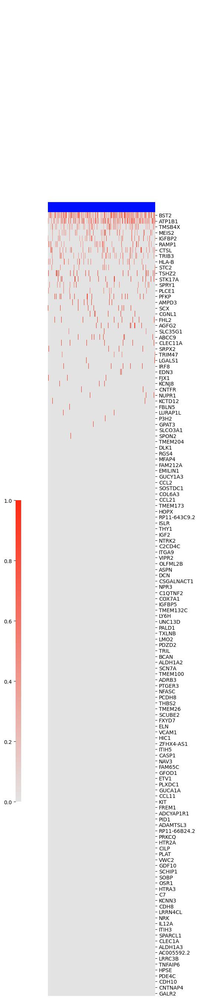

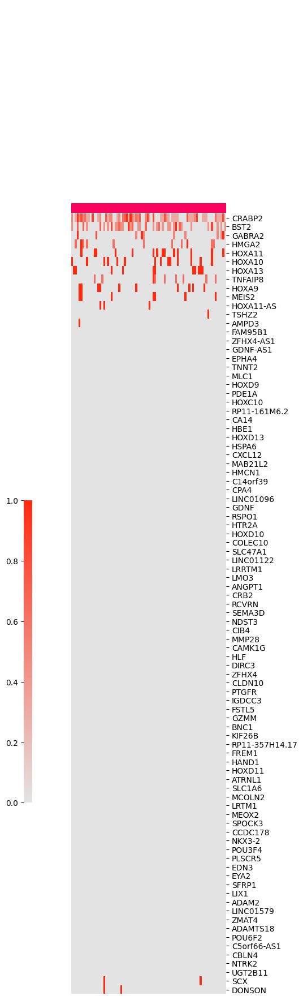

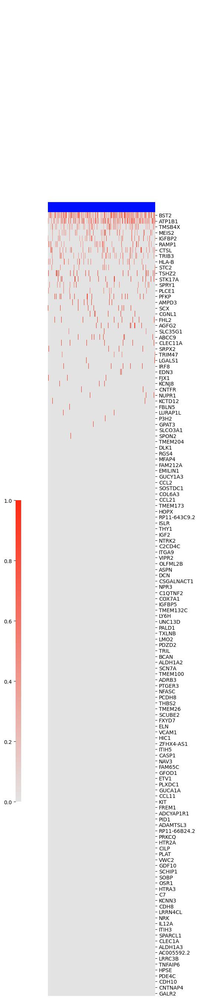

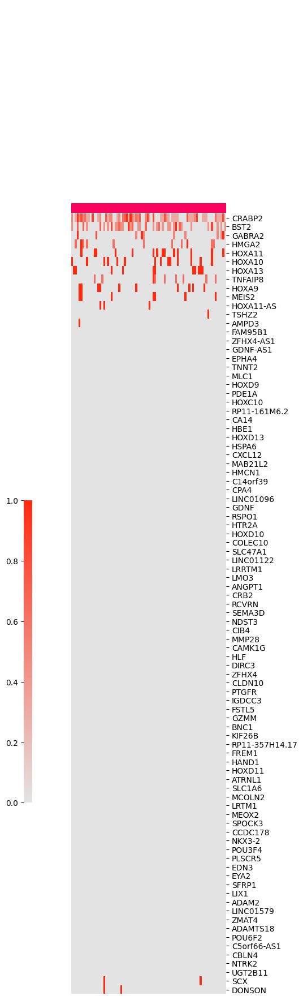

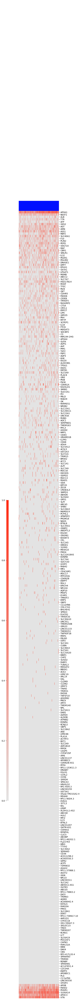

...

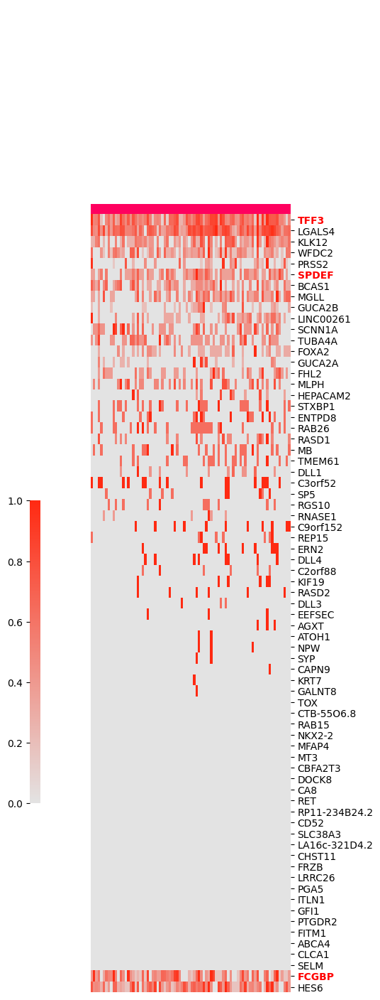

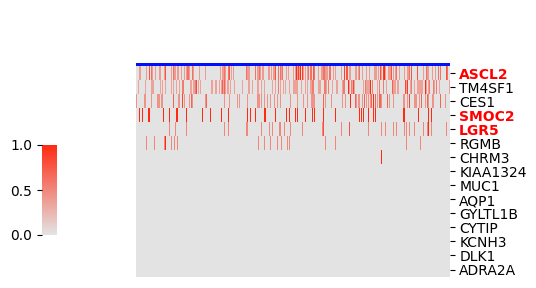

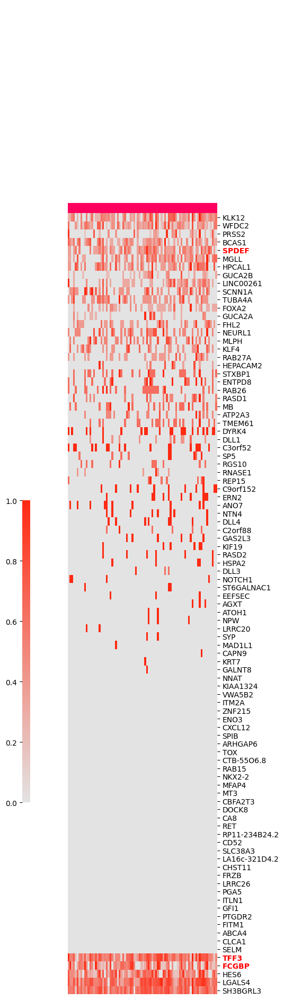

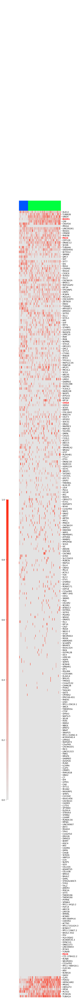

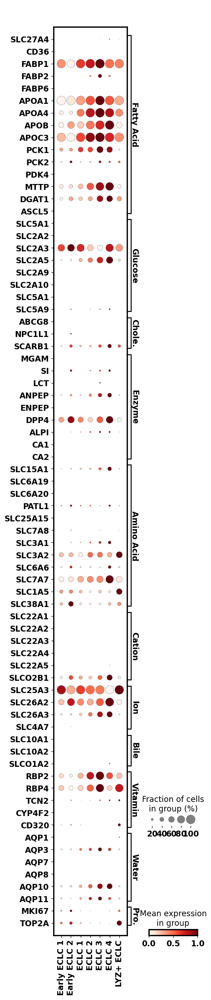

In [35]:
#matplotlib.rc_file_defaults()
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2}),
sc.pl.dotplot(adata_forvis[adata_forvis.obs['Detailed Cell Types'].isin(['Enterocyte like 1 (ECLC 1)',
    'Enterocyte like 2 (ECLC 2)',
    'Enterocyte like 3 (ECLC 3)',
    'Enterocyte like 4 (ECLC 4)',
    'Early Enterocyte like 1 (Early ECLC 1)',
    'Early Enterocyte like 2 (Early ECLC 2)',
              'LYZ+ Enterocyte like (LYZ+ ECLC)']),:],
              absb, 'Detailed Abbrv',vmax =1, swap_axes = True, dot_min = 0.05, standard_scale='var',save = 'id_tw_ec.png')

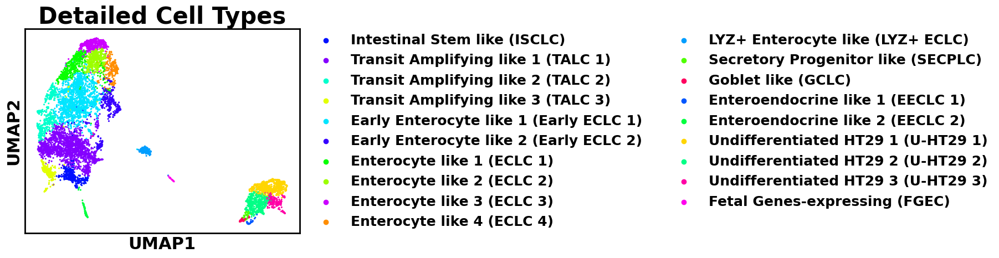

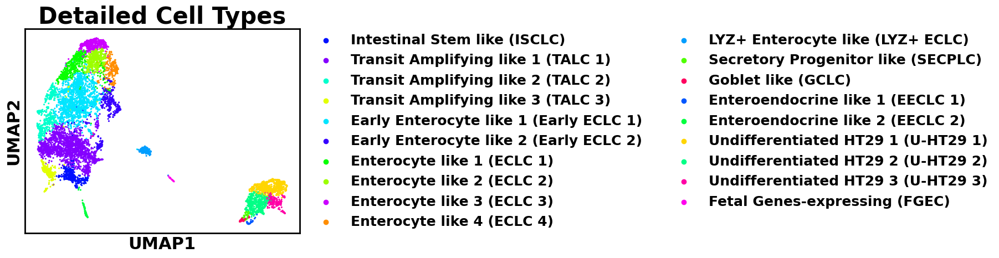

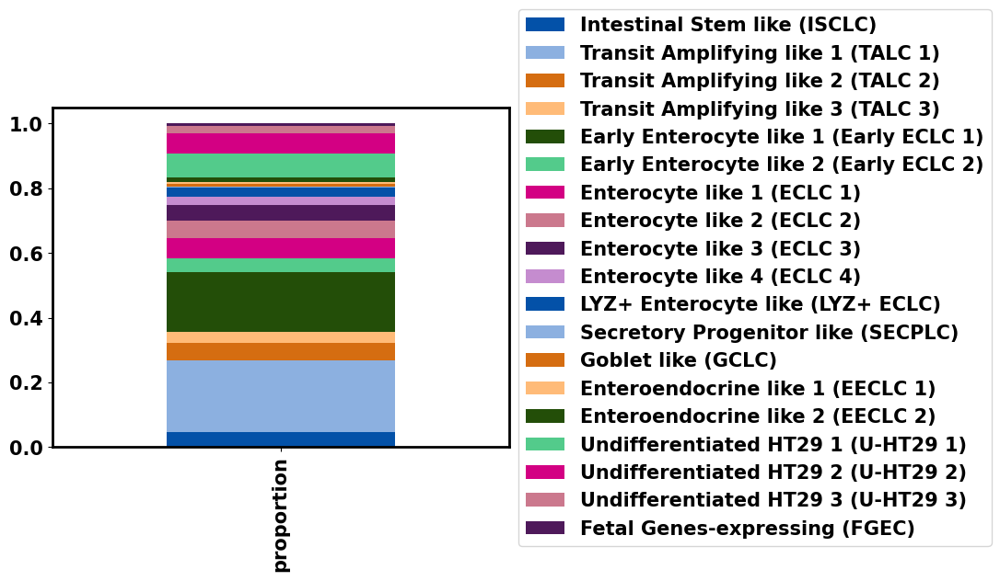

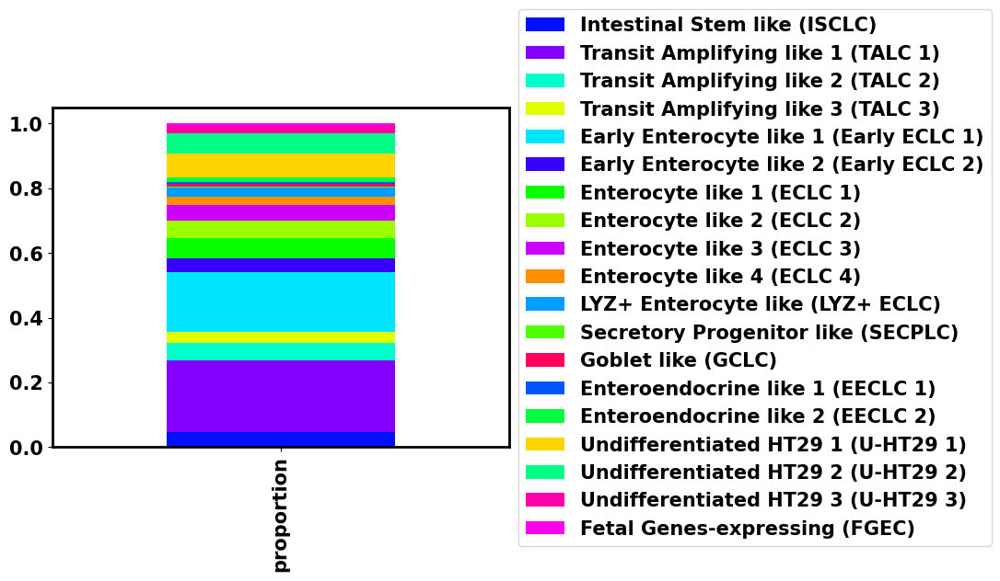

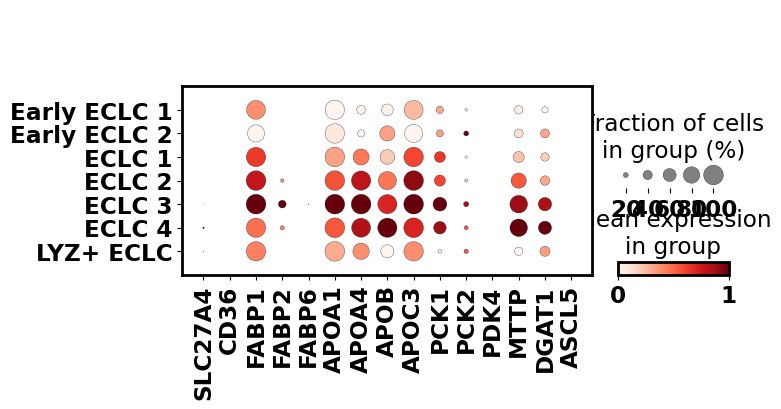

...

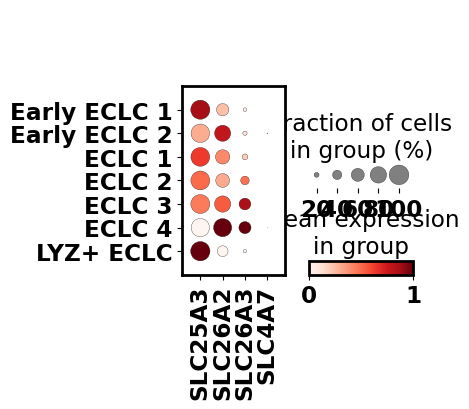

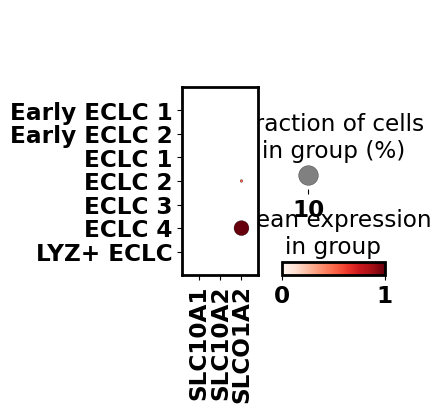

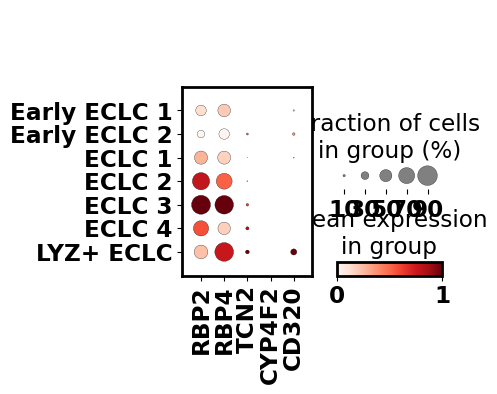

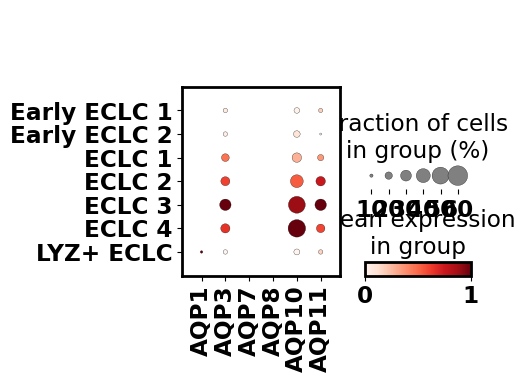

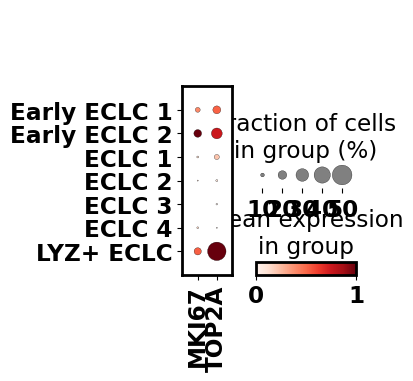

In [79]:
import matplotlib
#matplotlib.rc_file_defaults()
plt.rcParams.update({'font.size': 20, 'font.weight': 'bold','axes.linewidth':2})
plt.rcParams.update({'font.size': 20, 'font.weight': 'bold','axes.linewidth':2})
for i in absb.keys():
    sc.pl.dotplot(adata_forvis[adata_forvis.obs['Detailed Cell Types'].isin(['Enterocyte like 1 (ECLC 1)',
    'Enterocyte like 2 (ECLC 2)',
    'Enterocyte like 3 (ECLC 3)',
    'Enterocyte like 4 (ECLC 4)',
    'Early Enterocyte like 1 (Early ECLC 1)',
    'Early Enterocyte like 2 (Early ECLC 2)',
              'LYZ+ Enterocyte like (LYZ+ ECLC)']),:],
              absb[i], 'Detailed Abbrv', vmax =1, swap_axes = False, dot_min = 0.05,  standard_scale='var',save = i+'.png'
              )

### Dotplot for each celltype

In [ ]:
 ['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)',
            'Early Enterocyte like (Early ECLC)',
              'Enterocyte like (ECLC)',
             'Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)']

In [451]:
marker_genes = dict()
marker_genes['Stem'] = ['LGR5','SMOC2','ASCL2','AXIN2','RARRES2','OLFM4']
marker_genes['Cancer Stem'] = ['CD24','CD44','PROM1','SOX2']
marker_genes['Fetal Stem'] = ['ALB','AFP','FGB','FGG','PLA2G2A']
marker_genes['Proliferative'] = ['MKI67','TOP2A']
marker_genes['Other'] = ['DKK1','GNRH2']

In [472]:
import anndata
sig_list = []
for k,v in marker_genes.items():
    sig_list+=v

missing_genes = pd.Series(sig_list)[pd.Series(sig_list).isin(adata.var_names)==False]
new_variables_data = np.zeros((adata.n_obs, len(missing_genes)))
adata_forvis = anndata.AnnData(X=np.hstack([adata.X.A, new_variables_data]),
                        obs=adata.obs,
                        var=pd.DataFrame(index=list(adata.var.index) +list( missing_genes)))

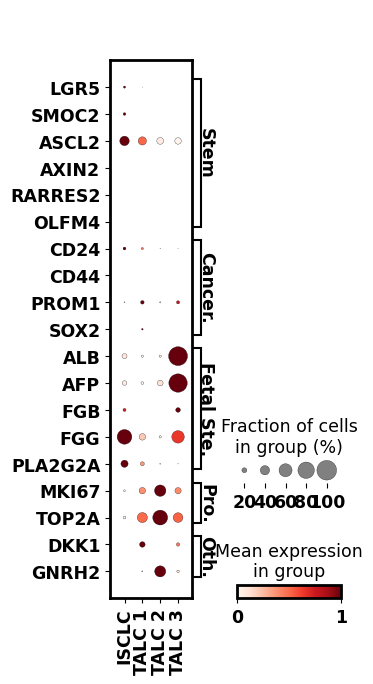

In [475]:
#matplotlib.rc_file_defaults()
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
sc.pl.dotplot(adata_forvis[adata_forvis.obs['General Cell Types'].isin(['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)']),:],
              marker_genes, 'Detailed Abbrv',vmax =1, swap_axes = True, dot_min = 0.05, standard_scale = 'var',save = 'id_stem.png')

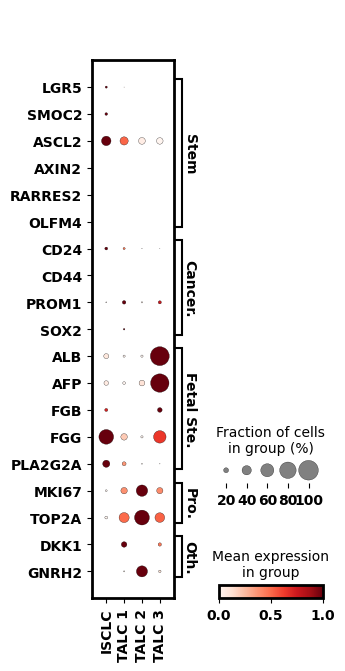

In [483]:
#matplotlib.rc_file_defaults()
plt.rcParams.update({'font.size': 12, 'font.weight': 'heavy','axes.linewidth':2})
sc.pl.dotplot(adata_forvis[adata_forvis.obs['General Cell Types'].isin(['Intestinal Stem like (ISCLC)',
             'Transit Amplifying like (TALC)']),:],
              marker_genes, 'Detailed Abbrv',vmax =1, swap_axes = True, dot_min = 0.05, standard_scale = 'var',save = 'dot_for_legend.png')

In [106]:
sec_sign = dict()
sec_sign['sig'] = ['RARRES2','TFF3']
sec_sign['Prog'] =['HES6','SOX4','STMN1']
sec_sign['Gob'] = ['MUC2','MUC5AC','TFF3','DLL1']
sec_sign['Early EEC'] = ['PAX4', 'INSM1'] 
sec_sign['EEC-L'] = ['GCG', 'UCN3', 'ETV1','PROX1']
sec_sign['EEC-D'] = ['SST']
sec_sign['Proliferative'] = ['MKI67','TOP2A']
sec_sign['Other'] = ['CD24', 'CD44', 'BMP4','AXIN2','KRT20','LYZ','IGFBP2','CXCR4','FOXA2','SLC12A2','FOXA2','SLC12A2']

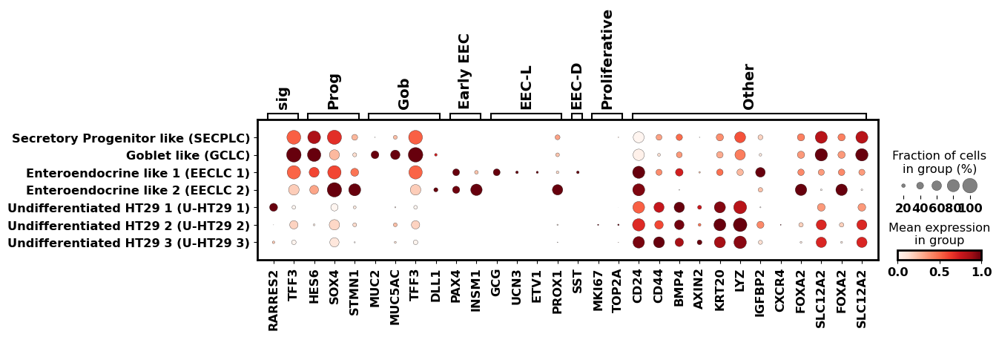

In [107]:
plt.rcParams.update({'font.size': 14, 'font.weight': 'bold','axes.linewidth':2})
sc.pl.dotplot(adata_forvis[adata_forvis.obs['General Cell Types'].isin(['Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Enteroendocrine like (EECLC)',
             'Undifferentiated HT29 (U-HT29)']),:],
              sec_sign, 'Detailed Cell Types', vmax =1, swap_axes = False, dot_min = 0.05, standard_scale = 'var',save = 'sec.png'
              )

### Pseudotime

In [95]:
adata_ptime = adata[adata.obs['General Cell Types'].isin(['Secretory Progenitor like (SECPLC)',
             'Goblet like (GCLC)',
             'Undifferentiated HT29 (U-HT29)']),:]             #'Enteroendocrine like 1(EECLC)',
sc.pp.filter_genes(adata_ptime, min_cells = 5)

filtered out 4496 genes that are detected in less than 5 cells


In [96]:
%%R -i adata_ptime
saveRDS(adata_ptime,'F:/Transwell/sec_ptime.rds')

### Supplement Dot

In [42]:
WNT_list= [gene for gene in adata.var_names if gene.startswith("WNT")]
list1 = ['LYZ','DEFA4','DEFA5','PRSS2','ITLN2','BEX5','YAP1','FZD2','TCF4','BEX5','CD24', 'CD44', 'BMP4','LGR5','ASCL2', 'SMOC2']
list2 = ['TJP1','OCLN','CLDN1','CLDN7','TNF','IL1B','IFNG','TLR4','TLR2','CD14','LY96','MYC','HES1','ID1','ANKRD1','FZD2','FZD3','FZD4',
        'FZD5','FZD6','FZD7','SOX9']
supp_list = WNT_list + list1+list2

In [43]:
missing_genes = pd.Series(supp_list)[pd.Series(supp_list).isin(adata.var_names)==False]
new_variables_data = np.zeros((adata.n_obs, len(missing_genes)))
adata_forvis = anndata.AnnData(X=np.hstack([adata.X.A, new_variables_data]),
                        obs=adata.obs,
                        var=pd.DataFrame(index=list(adata.var.index) +list( missing_genes)))

In [44]:
adata_forvis.var_names_make_unique()

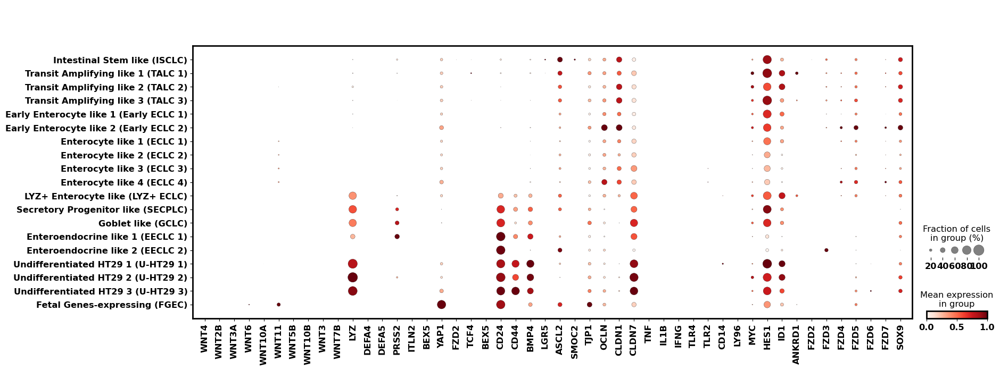

In [45]:
plt.rcParams.update({'font.size': 14, 'font.weight': 'bold','axes.linewidth':2})
sc.pl.dotplot(adata_forvis,
              supp_list, 'Detailed Cell Types', vmax =1, swap_axes = False, dot_min = 0.05, standard_scale = 'var',save = 'supplement.png'
              )

### Validate if any of these clusters is formed by mainly 1) mitochondiral 2) ribosome 3) cell counts. 
Also check the fraction of each condition in each cluster to see if a cluster is mainly formed by a certain condition

<Figure size 1200x1200 with 0 Axes>

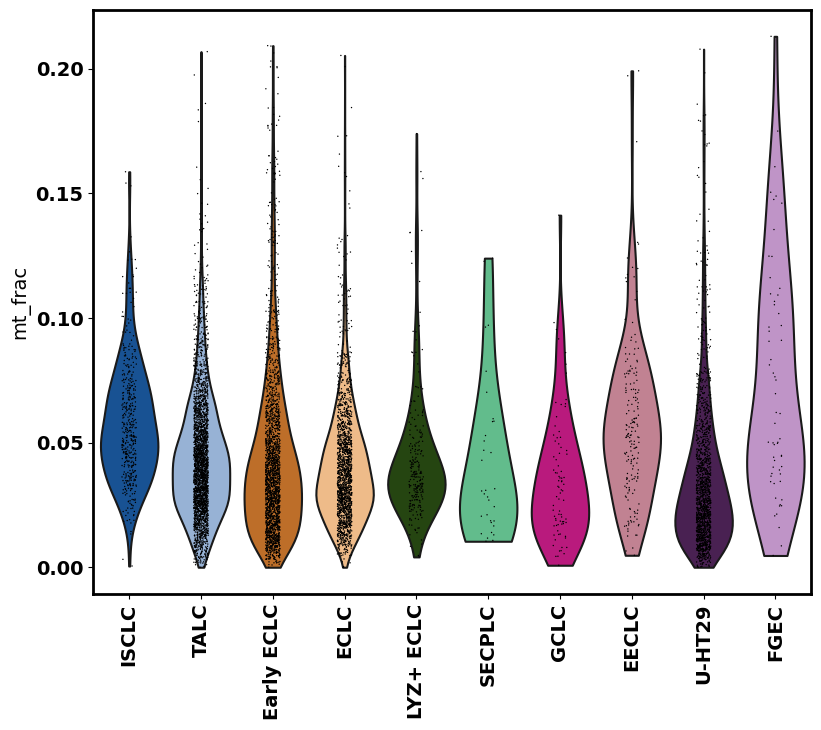

In [109]:
plt.figure(figsize=(8, 8), dpi=150)
t2 = sc.pl.violin(adata, 'mt_frac',groupby = 'General Abbrv',save = 'qc_mt.png',rotation = 90)